<a href="https://colab.research.google.com/github/CapitalData/OpenSourceDataScienceAICore/blob/main/Session_4_Advanced_SQL.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## **Session_4 : Advanced SQL**

---
### **Introduction**

**After mastering the fundamentals and intermediate concepts of SQL, it’s time to explore Advanced SQL. This level focuses on techniques that offer greater control over data management, enhanced query performance, and deeper insights through complex operations.**

Advanced SQL concepts are widely used in large-scale enterprise applications, data engineering pipelines, and analytical environments. Understanding these concepts will help you work efficiently with massive datasets, optimize queries, and ensure data integrity.

---
### **Learning objective**

#### **By the end of this topic we will be able to learn:**
- **Indexes & Performance Optimization**
  - Clustered vs Non-Clustered Indexes
  - How Indexing Improves Query Performance
- **Analyzing Queries with EXPLAIN PLAN**
- **Stored Procedures and Functions**
  - Creating and Using Stored Procedures
  - User_Defined Functions
- **Triggers and Event Scheduling**
  - What are Triggers?
  - Creating Triggers for Automated Actions
  - Using Scheduled Events
- **Views and Materialized Views**
  - Creating and Managing Views
  - Difference Between Views and Materialized Views
- **Window Functions**
  - RANK(),
  - DENSE_RANK(),
  - ROW_NUMBER()
  - Using PARTITION BY and OVER()
- **Pivot And Unpivot**  

#### **Indexes & Performance Optimization**

- One of the physical storage structures provided by most SQL-based database management systems is **an index.**
- It provides rapid access to the rows of a table based on the values of one or more columns.
-  One of the most effective ways to optimize database queries.
-  It enhances the speed of data retrieval operations, reducing the time and resources required to fetch results.
- Indexes are created on one or more columns of a table, providing faster lookups for SELECT, WHERE, JOIN, and ORDER BY operations.
- Only the PRIMARY KEY or the first non-NULL UNIQUE KEY can be the clustered index, and they will be the clustered index without you choosing.
- All the other indexes in the table are implicitly non-clustered.
- **Syntax**:
```
CREATE INDEX index_name
ON table_name (column1, column2, ...);
```
- **Types of Indexes**
  1. **Single-Column Ind**ex
   - Created on a single column to speed up lookups.
   - Example:
    ```
    CREATE INDEX idx_employee_name
    employees (name);
    ```
  2. **Composite Index**
    - Created on multiple columns. Ideal for queries with multiple conditions.
    - Example:
    ```
    CREATE INDEX idx_employee_name_department
    ON employees (name, department);
    ```
  3. **Unique Index**
     - Ensures all column values are unique, similar to the UNIQUE constraint.
     - Example:
      ```
      CREATE UNIQUE INDEX idx_unique_email
      ON employees (email);
      ```
  4. **Clustered Index**
     - Determines the physical order of data in a table. Each table can have only one clustered index.
     - The Primary Key creates a clustered index by default.
     - Data is physically sorted based on the indexed column.
     - Faster for queries that involve range-based searches or sorting.
     - Useful for columns that are frequently used in ORDER BY or GROUP BY.
     - Efficient for queries that return large ranges of data.
     - Example:
       ```
        CREATE CLUSTERED INDEX idx_order_id
        ON orders (order_id);
        ```
  5. **Non-Clustered Index**
    - Maintains a separate structure from the actual table and points to the data location.
    - All indexes are implicitly non-clustered.
    - Example:
     ```
      CREATE INDEX idx_customer_name
      ON customers (last_name);
      ```
    - It provides a faster lookup for data.
    - Stores pointers to the rows containing the data.
    - Multiple non-clustered indexes can exist on a table.
    - Suitable for columns frequently used in searches, joins, and WHERE clauses.
    - Helps in optimizing the performance of read-intensive operations.
      
  








#### **How Indexes Improve Performance**
- **Faster Search**:
  - Indexes reduce the number of rows the database scans to find results.

- **Optimized Sorting**:
  - Queries with ORDER BY and GROUP BY benefit from indexes.

- **Efficient Joins:**
  - Indexes help in quickly identifying matching rows across multiple tables.

- **Reduced I/O Operations:**
  - Less data needs to be read from storage, improving query speed.

 **Drop Index**
 - To remove index.
 - Syntax:
  ```
  DROP INDEX index_name
  ON table_name;
  ```

**View Indexes**
- To check existing indexes on a table.
- Syntax;
 ```
 SHOW INDEX FROM table_name;
 ```
- Example:
 ```
  SHOW INDEX FROM Customer;
  ```

---
### **Lab**

**Lab 4.1: Working with Indexes for Performance Optimization**
- Create and manage clustered and non-clustered indexes.

- Analyze query performance using indexes.

- Optimize queries by applying appropriate indexes.

**1. Create the Tables and Insert Data**

```
-- Create a Product table
CREATE TABLE Products (
    ProductID INT PRIMARY KEY,
    ProductName VARCHAR(50) NOT NULL,
    Category VARCHAR(20),
    Price DECIMAL(10,2),
    Stock INT
);

-- Insert sample data
INSERT INTO Products (ProductID, ProductName, Category, Price, Stock)
VALUES
(1, 'Laptop', 'Electronics', 1200.50, 50),
(2, 'Phone', 'Electronics', 800.75, 150),
(3, 'Headphones', 'Accessories', 150.00, 200),
(4, 'Refrigerator', 'Appliances', 1800.00, 30),
(5, 'Blender', 'Appliances', 120.00, 60);
```

**2: Create Indexes**

**2.1 Create a Non-Clustered Inde**
```
CREATE NONCLUSTERED INDEX IX_Category
ON Products (Category);
```
**2.2 Create a Composite Index**
```
CREATE NONCLUSTERED INDEX IX_Category_Price
ON Products (Category, Price);
```

**3: Perform Queries and Analyze Performance**

**Query Without Index**
- Execute query before creating index.
- ```
EXPLAIN SELECT * FROM Products WHERE Category = 'Electronics';
```
- Analyze how the query is scanning the table.



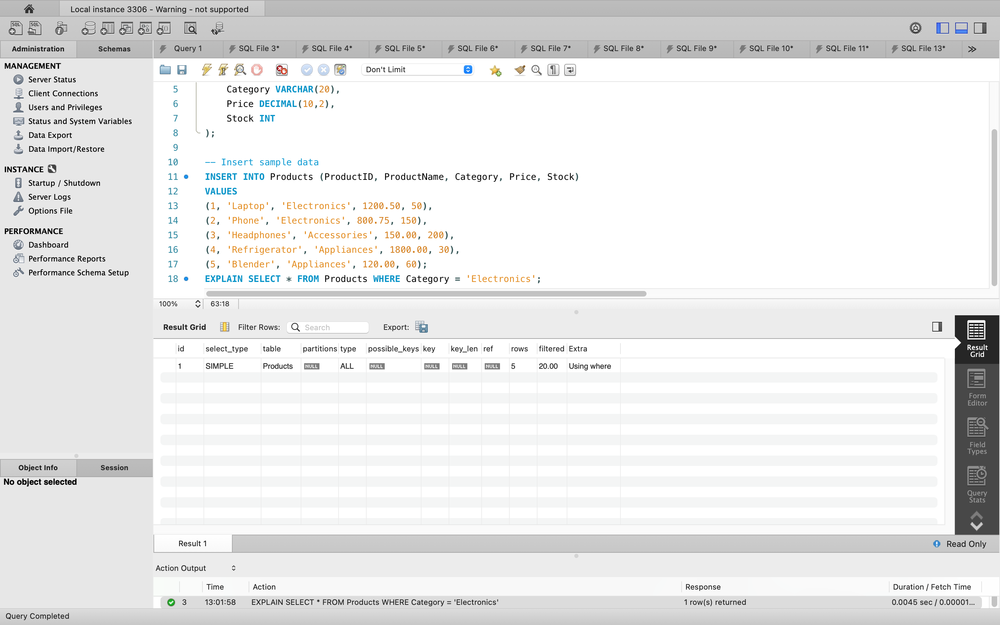

**Query With Non-Clustered Index**
- After creating the index, run the same query:
```
EXPLAIN SELECT * FROM Products WHERE Category = 'Electronics';
```


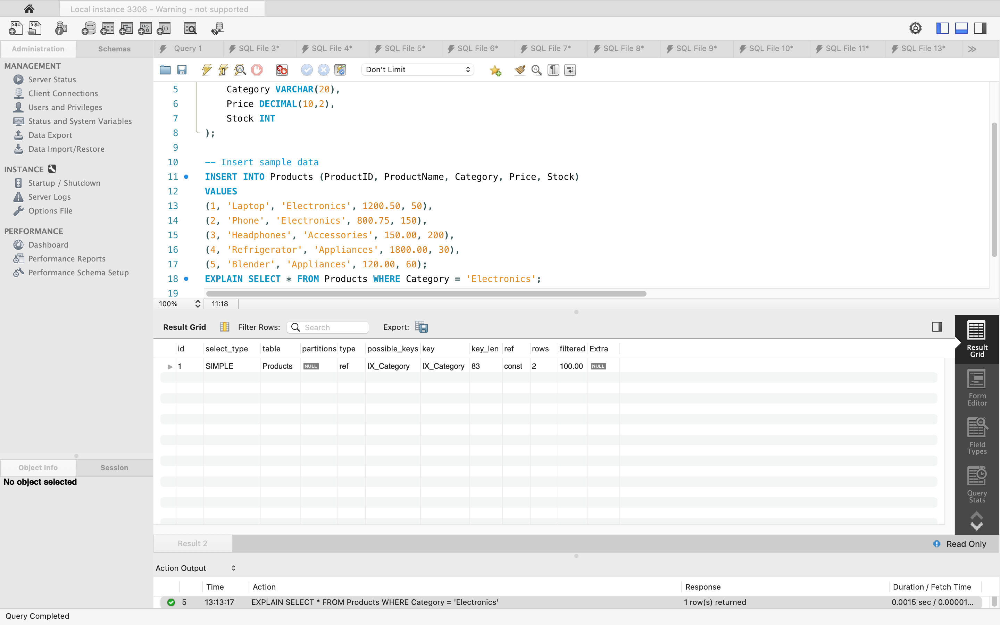

**Notice the difference in query execution time.**

**Try this**
1. Create a clustered index on Price and observe how the query performs
2. Write a query to find all products within a price range using the clustered index:
```
SELECT * FROM Products WHERE Price BETWEEN 100 AND 900;
```
3. Compare performance with and without indexes.

### **Analyzing Queries with EXPLAIN PLAN**

####**What is it?**
- EXPLAIN PLAN helps analyze how a SQL query is executed by the database, showing details about execution steps, indexes used, joins, and estimated costs.
- This is useful for optimizing queries and improving performance.
- To analyze SQL queries using **EXPLAIN PLAN**, you can use the **EXPLAIN** command before your query to see the database's execution plan, which shows how the query will be processed, including table scans, joins, and costs.
- **EXPLAIN ANALYZE** further executes the query and provides actual execution statistics like time and rows processed.

#### **Syntax**
- **Basic EXPLAIN**
```
EXPLAIN SELECT * FROM table_name WHERE column_name = 'value';
```
- **EXPLAIN ANALYZE (For Detailed Execution Plan)**
```
EXPLAIN ANALYZE SELECT * FROM table_name WHERE column_name = 'value';
```


**EXPLAIN**

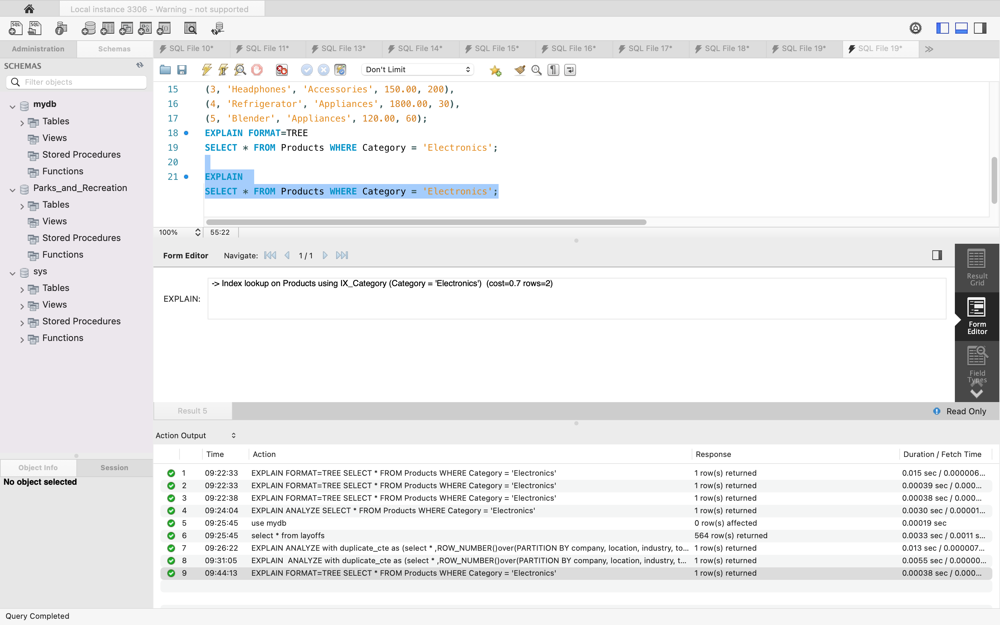

**EXPLAIN ANALYZE**

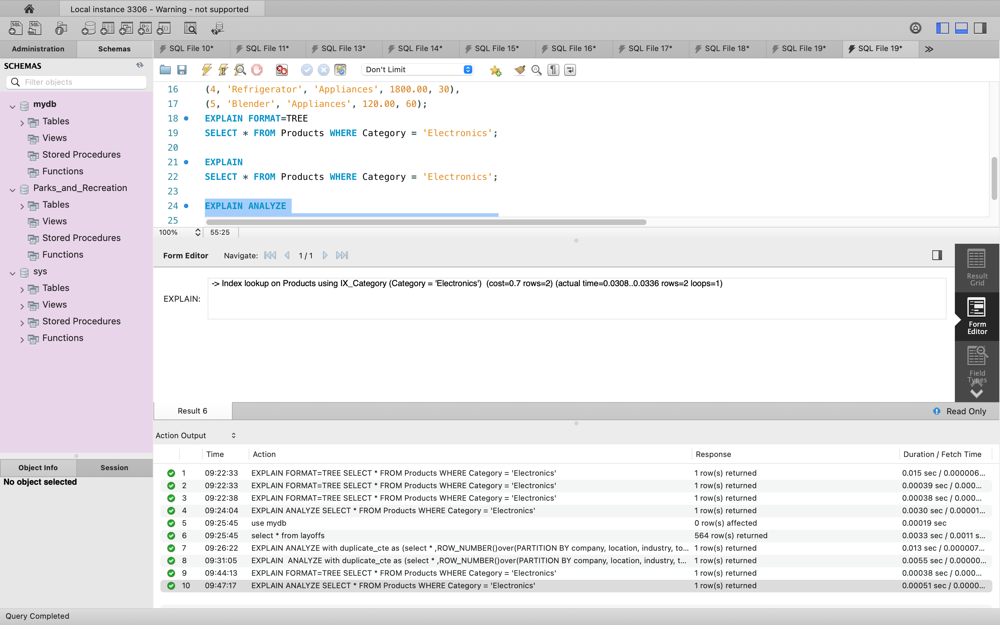

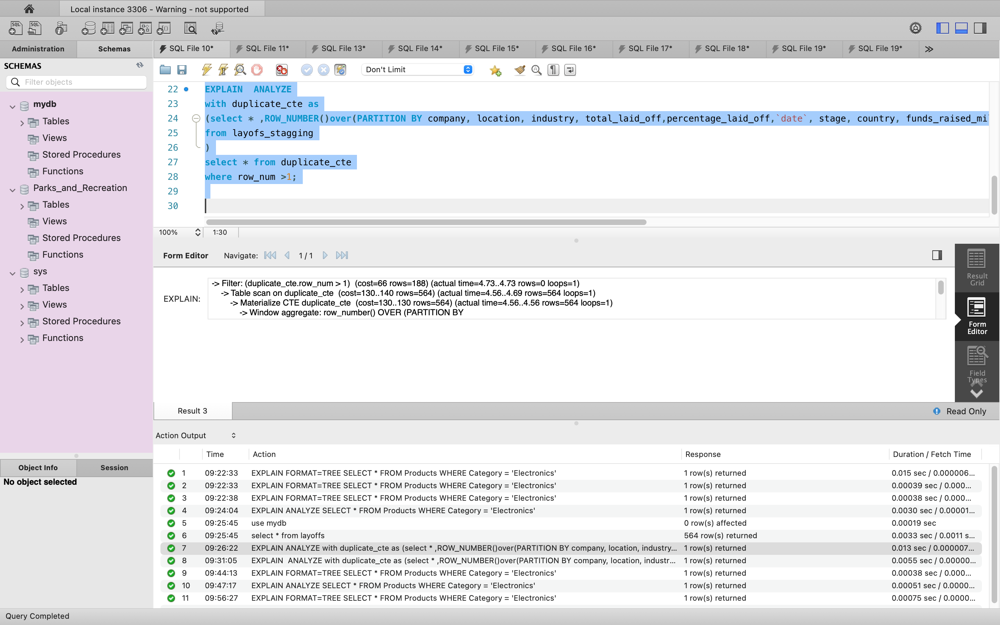

**There are several  measurements here:**
- Actual time to get first row (in milliseconds)
- Actual time to get all rows (in milliseconds)
- Actual number of rows read
- Actual number of loops

**Observations**
- Our Filter output for the first example,estimated cost is 0.7 and estimated to return 2 rows.
- The actual time, “0.0308..0.0336”, which means that it took on average 0.0308 ms to read the first row, and 0.0336 ms to read all rows(2).

####**Why it's important:**
- Analyzing the execution plan helps identify potential performance bottlenecks and optimize queries for better performance.

#### **Interpreting the Plan:**
- **Tree Structure:** The execution plan is often presented as a tree, where each node represents a step in the execution process.
- **Operations:** Nodes can represent various operations like table scans, index lookups, joins, and sorting.
- **Cost Estimates:** The plan may include estimated costs for each operation, which can help identify expensive steps.
- **Actual Statistics**: EXPLAIN ANALYZE provides actual execution statistics, such as the time taken and the number of rows processed, which can be compared to the estimated costs.

####**Simple hints to get you started are:**

- If you wonder what it’s taking so long, look at the timing. Where does the executor spend its time?
- If you wonder why the optimizer chose that plan, look at the row counters.
-  A large difference (i.e., a couple of orders of magnitude or more) between the estimated number of rows and the actual number of rows is a sign that you should look closer at it.
- The optimizer chooses its plan based on the estimate, but looking at the actual execution may tell you that another plan would have been better.
- **Factors influencing cost**:
   - The cost is calculated based on factors like the estimated number of single and multi-block reads, CPU consumption, and other resource usage.
   - The optimizer selects the plan with the lowest estimated cost, assuming that the plan with the lowest cost will be the most efficient.


#### **LAB**

**Lab: Analyzing Queries with EXPLAIN PLAN**
- In this lab, you will use EXPLAIN and EXPLAIN ANALYZE to analyze query execution plans and optimize performance.

 ### **Stored Procedures and Functions**
  - Understand the purpose and advantages of stored procedures and functions.
  - Create and execute stored procedures.
  - Define and use user-defined functions (UDFs).
  - Differentiate between stored procedures and functions.



####**What are Stored Procedures?**
- A stored procedure is a reusable SQL script that is stored in the database and can be executed multiple times.
- It helps in code reusability, performance optimization, and security.
- Best practice is to use a delimiter and a Begin and End to really control what's in the stored procedure.

####**What are Functions?**
- A user-defined function (UDF) is a SQL function that performs a specific task and returns a value.
- Functions are mainly used to encapsulate logic that can be reused across queries.

####**Creating and Using Stored Procedures**
**Steps to Create Stored Procedure:**
- Names the procedure
- Creates the stored procedure
- Defines the parameters and their attributes
- Provides other information about the procedure which will be used when the procedure is called
- Defines the procedure body
- Execute it with CALL.

**Syntax:**
```
 -- Defining Procedure
DELIMITER //
CREATE PROCEDURE name_of_procedure()
BEGIN
SQL Statements
END //
DELIMITER;

-- Executing porcedure
CALL name_of_procedure;
```

**Example:**
```
DELIMITER //

CREATE PROCEDURE GetEmployeeDetails(IN emp_id INT)
BEGIN
    SELECT name, department, salary
    FROM employees
    WHERE id = emp_id;
END //

DELIMITER ;
```

**Example**: **Stored** procedure with In and Out parameters
```
DELIMITER $$

CREATE PROCEDURE GetEmployeeBonus(
    IN emp_id INT,         -- Input Parameter
    OUT emp_bonus DECIMAL(10,2),  -- Output Parameter
    INOUT total_sales DECIMAL(10,2)  -- Input/Output Parameter
)
BEGIN
    -- Retrieve the bonus based on employee ID
    SELECT bonus INTO emp_bonus FROM employees WHERE id = emp_id;
    
    -- Update total sales by adding the employee's sales
    SELECT SUM(sales) INTO total_sales FROM sales WHERE employee_id = emp_id;
END $$

DELIMITER ;
```
**How to Call Procedure?**
```
-- Declare variables to store output
SET @bonus = 0;
SET @sales = 5000; -- Initial value

-- Call the procedure
CALL GetEmployeeBonus(101, @bonus, @sales);

-- Check the output values
SELECT @bonus AS EmployeeBonus, @sales AS UpdatedTotalSales;
```

**Explanation:**
- IN Parameter (emp_id): Takes the employee ID as input.

- OUT Parameter (emp_bonus): Returns the bonus of the given employee.

- INOUT Parameter (total_sales): Takes an initial value, updates it, and returns the modified total.


##### **What is DELIMITER?**
-  The DELIMITER command is used to change the statement delimiter from the default semicolon (;) to another symbol.
- This is useful when writing stored procedures, functions, and triggers where multiple SQL statements are grouped together.

**Why Use DELIMITER?**
- MySQL treats ; as the end of a statement.
- When writing stored procedures or functions, multiple statements are enclosed within BEGIN ... END.
- To avoid confusion, we change the delimiter (e.g., // or $$) before defining the procedure and reset it back to ; after completing it.

**DROP Procedure**
- To drop (delete) a stored procedure.
- **Syntax:**
```
 DROP PROCEDURE IF EXISTS procedure_name;
 ```
 - **Example:**
 ```
   DROP procedure IF EXISTS `large_salaries3`;
   -- it automatically adds the dilimiter for us
   DELIMITER $$
   CREATE PROCEDURE large_salaries3(employee_id_param INT)
   BEGIN
	    SELECT *
	    FROM employee_salary
	    WHERE salary >= 60000
    AND employee_id_param = employee_id;
   END $$

   DELIMITER ;
  ```


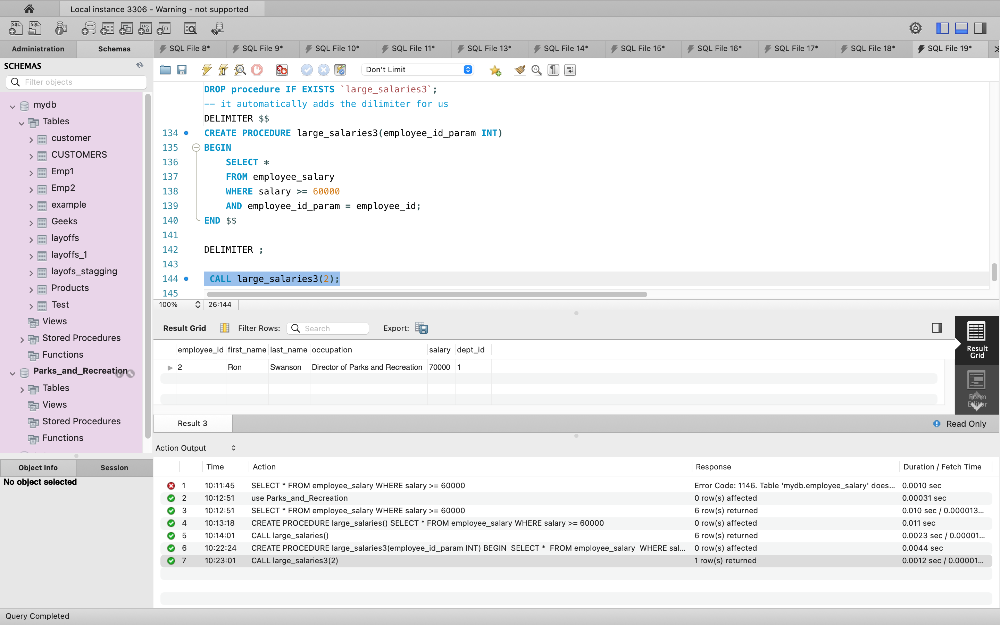

### **Define and Use user-defined functions (UDFs)**



- In SQL, a user-defined function (UDF) allows you to encapsulate logic that can be reused across multiple queries.
- **Syntax:**
```
CREATE FUNCTION function_name(parameters)
RETURNS return_data_type
DETERMINISTIC
BEGIN
    -- Function logic goes here
    RETURN value;
END;
```
- DETERMINISTIC - Indicates that for the same input, the function always returns the same output.
- **Example: A Function to Calculate Bonus**
- Let's create a function CalculateBonus that takes an employee's salary and returns a bonus (10% of the salary).
```
  DELIMITER $$
  --Define function to calculate bonus
  CREATE FUNCTION CalculateBonus(salary DECIMAL(10,2))
  RETURNS DECIMAL(10,2)

  DETERMINISTIC
  BEGIN
    DECLARE bonus DECIMAL(10,2);
    SET bonus = salary * 0.10;
    RETURN bonus;
  END $$

  DELIMITER ;
```
```
 -- Call udf
SELECT CalculateBonus(5000) AS Bonus;
```


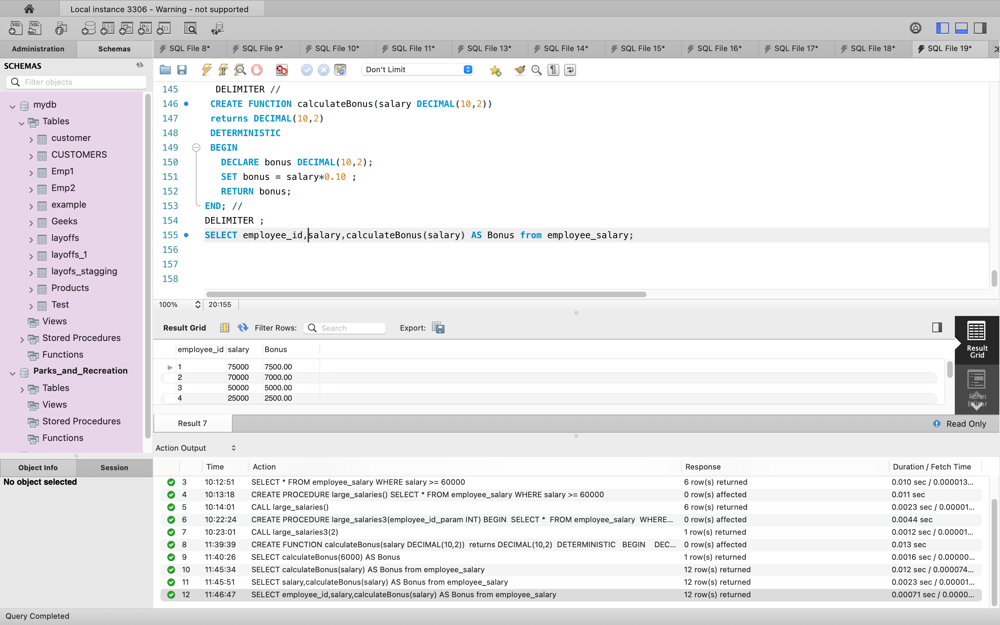

####**Differentiate Between Stored Procedure And User Define Functions**

**Feature**| **Stored Procedure**|**Function**
--------|-----------------|--------------
**Purpose**	|Used to perform a set of operations (e.g., modifying data, performing transactions).|	Used to compute and return a single value or table result.
**Return Value**	|Can return multiple values using OUT parameters or result sets.|	Must return a single value (scalar, table, or JSON) using RETURN.
**Calling Mechanism**|	Called using CALL procedure_name(...).	|Called inside SQL queries like SELECT function_name(...).
**DML Operations (INSERT, UPDATE, DELETE)**|Allowed inside the procedure. Can modify database tables.	|Generally not allowed to modify database tables (except some special cases in PL/pgSQL).
**Use in Queries**|	Cannot be used inside SELECT, WHERE, or JOIN clauses.	|Can be used inside SELECT, WHERE, HAVING, and JOIN clauses.
**Transaction Control (COMMIT, ROLLBACK)**|	Allowed inside a procedure.|	Not allowed inside a function.
**Execution Type**|	Executes as a script, not necessarily returning a value.	|Returns a value or table result.
**Performance**|	Can be slower in some cases due to transaction handling.	|Faster for computations because it doesn’t handle transactions.

**Lab**: **Stored Procedures and Functions**
- This lab will guide you through creating and using Stored Procedures and Functions in SQL.



**1. Setting Up the Database**
- Run the following script to create a sample database and table for testing:
```
 CREATE DATABASE EmployeeDB;
 USE EmployeeDB;

   CREATE TABLE Employees (
    EmployeeID INT PRIMARY KEY AUTO_INCREMENT,
    Name VARCHAR(50),
    Department VARCHAR(50),
    Salary DECIMAL(10,2)
  );

  INSERT INTO Employees (Name, Department, Salary)
  VALUES
  ('Alice Johnson', 'HR', 50000),
  ('Bob Smith', 'IT', 75000),
  ('Charlie Brown', 'Finance', 65000),
  ('David Lee', 'IT', 72000);
 ```


**2. Creating and Using a Stored Procedure**
- Task: Create a stored procedure to retrieve employee details by department.
```
  DELIMITER $$

  CREATE PROCEDURE GetEmployeesByDepartment(IN dept VARCHAR(50))
   BEGIN
      SELECT * FROM Employees WHERE Department = dept;
   END $$

  DELIMITER ;
  ```
- CAll Store procedure GetEmployeeByDepartment
```
  CALL GetEmployeesByDepartment('IT');
```


**3. Creating a Stored Procedure with Input & Output Parameters**
- Task: Create a stored procedure to calculate the average salary for a department and return it as an output parameter.
```
 DELIMITER $$

 CREATE PROCEDURE GetAvgSalary(
    IN dept VARCHAR(50),
    OUT avgSalary DECIMAL(10,2)
  )
 BEGIN
    SELECT AVG(Salary) INTO avgSalary FROM Employees WHERE Department = dept;
  END $$

 DELIMITER ;
```
- Execute Procedure
 ```
  CALL GetAvgSalary('IT', @avg);
  SELECT @avg AS AverageSalary;
```

**4. Creating and Using a Function**
- Task: Create a function to retrieve an employee’s salary by their EmployeeID.
```
 DELIMITER $$

 CREATE FUNCTION GetEmployeeSalary(emp_id INT) RETURNS DECIMAL(10,2)
 DETERMINISTIC
 BEGIN
    DECLARE empSalary DECIMAL(10,2);
    SELECT Salary INTO empSalary FROM Employees WHERE EmployeeID = emp_id;
    RETURN empSalary;
 END $$

 DELIMITER ;
```
- EXECUTE QUERY
```
 SELECT GetEmployeeSalary(2) AS EmployeeSalary;
```

**5. Function with Conditional Logic**
- Task: Create a function to determine the employee's tax category based on salary.
```
 DELIMITER $$
  CREATE FUNCTION GetTaxCategory(salary DECIMAL(10,2)) RETURNS VARCHAR(20)
  DETERMINISTIC
  BEGIN
     DECLARE taxCategory VARCHAR(20);
    
    IF salary < 60000 THEN
        SET taxCategory = 'Low Tax Bracket';
    ELSEIF salary BETWEEN 60000 AND 80000 THEN
        SET taxCategory = 'Medium Tax Bracket';
    ELSE
        SET taxCategory = 'High Tax Bracket';
    END IF;
    
    RETURN taxCategory;
  END $$

  DELIMITER ;
```
- Use Function in query
```
 SELECT Name, Salary, GetTaxCategory(Salary) AS TaxCategory FROM Employees;
```

**6. Dropping a Stored Procedure and Function**
- If you need to remove the stored procedure or function:
```
 DROP PROCEDURE IF EXISTS GetEmployeesByDepartment;
 DROP FUNCTION IF EXISTS GetEmployeeSalary;
```

###**Triggers and Event Scheduling**

- What are Triggers?
- Creating Triggers for Automated Actions
- Using Scheduled Events

####**What are Triggers?**
- A trigger is a special type of stored procedure in SQL that is automatically executed (or "triggered") when a specified event occurs in a table.
- Triggers are mainly used to enforce business rules, maintain data integrity, and automate processes.
- Common events that activate triggers include INSERT, UPDATE and DELETE.


**Syntax**
```
  CREATE TRIGGER trigger_name
  [BEFORE | AFTER] [INSERT | UPDATE | DELETE]
  ON table_name
  FOR EACH ROW
  BEGIN
    -- SQL statements
  END;
  ```

#### **Creating Triggers for Automated Actions**

**Types of Triggers**
- Triggers can be classified based on:

  - Timing:
   - BEFORE Triggers – Execute before the operation (INSERT, UPDATE, DELETE).

   - AFTER Triggers – Execute after the operation.

 -  Triggering Event

   - INSERT Triggers – Fires when a new row is inserted.

   - UPDATE Triggers – Fires when an existing row is updated.

   - DELETE Triggers – Fires when a row is deleted.
 - Scope of Execution
   - Row-Level Trigger
     - Executes once per row affected by INSERT, UPDATE, or DELETE.
     - Ideal for logging individual changes.
   - Statement-Level Trigger
     - Executes once per statement, regardless of the number of rows affected.
     - Ideal for tracking table modifications.  

- **Example of BEFORE Trigger**
```
 -- Prevent negative salary updates.
DELIMITER //
CREATE TRIGGER before_salary_update
BEFORE UPDATE ON Employees
FOR EACH ROW
BEGIN
    IF NEW.Salary < 0 THEN
        SIGNAL SQLSTATE '45000'
        SET MESSAGE_TEXT = 'Salary cannot be negative';
    END IF;
END;
//
DELIMITER ;
```
- **Example of AFTER Trigger**
```
 -- Log every salary update
DELIMITER //
CREATE TRIGGER after_salary_update
AFTER UPDATE ON Employees
FOR EACH ROW
BEGIN
    INSERT INTO Salary_Audit (EmpID, OldSalary, NewSalary)
    VALUES (OLD.EmpID, OLD.Salary, NEW.Salary);
END;
//
DELIMITER ;
```
- **Example Of INSERT Triggers**
```
 -- Automatically assign a default department if none is provided.
DELIMITER //
CREATE TRIGGER before_insert_employee
BEFORE INSERT ON Employees
FOR EACH ROW
BEGIN
    IF NEW.Department IS NULL THEN
        SET NEW.Department = 'General';
    END IF;
END;
//
DELIMITER ;
```
- **Example Of UPDATE Triggers**
 ```
  --  Ensure salaries don’t decrease.
 DELIMITER //
 CREATE TRIGGER prevent_salary_decrease
 BEFORE UPDATE ON Employees
 FOR EACH ROW
 BEGIN
    IF NEW.Salary < OLD.Salary THEN
        SIGNAL SQLSTATE '45000'
        SET MESSAGE_TEXT = 'Salary cannot be decreased';
    END IF;
 END;
 //
 DELIMITER ;
```
- **Example Of DELETE Triggers**
```
 --  Move deleted employees to an archive table.
DELIMITER //
CREATE TRIGGER after_employee_delete
AFTER DELETE ON Employees
FOR EACH ROW
BEGIN
    INSERT INTO Employees_Archive (EmpID, Name, Position, Salary)
    VALUES (OLD.EmpID, OLD.Name, OLD.Position, OLD.Salary);
END;
//
DELIMITER ;
```
- **Example Of ROW Level Trigger**
```
 -- Log salary updates for each employee.
CREATE TRIGGER row_level_salary_log
AFTER UPDATE ON Employees
FOR EACH ROW
BEGIN
    INSERT INTO Salary_Audit (EmpID, OldSalary, NewSalary)
    VALUES (OLD.EmpID, OLD.Salary, NEW.Salary);
END;
```
- **Example of Statement Level Trigger**
```
 --Track the number of updates on the Employees table.
CREATE TRIGGER statement_level_employee_update
AFTER UPDATE ON Employees
FOR EACH STATEMENT
BEGIN
    UPDATE Update_Log
    SET UpdateCount = UpdateCount + 1
    WHERE TableName = 'Employees';
END;
```

#### **Operations with SQL triggers**
 1. Creating triggers
 2. Modifying and deleting triggers
 3. Displaying existing triggers


**1. Creating Triggers**
- Creating a trigger involves defining when it should be executed and what actions it should perform.
- The example above shows how to make a trigger that logs updates to an employees table.
```
CREATE TRIGGER after_employee_delete
AFTER DELETE ON employees
FOR EACH ROW
BEGIN
    INSERT INTO employees_log (employee_id, name, action)
    VALUES (OLD.employee_id, OLD.name, 'deleted');
END;
```


**2. Modifying and deleting triggers**
- To modify a trigger, you must drop the existing one and create a new one with the desired changes.
- SQL does not provide a direct ALTER TRIGGER statement to modify an existing trigger.
- Instead, you must drop the existing trigger and recreate it with the modifications.
- Syntax:
```
 -- First Drop the Trigger if exist
DROP TRIGGER IF EXISTS trigger_name;
 -- Recreate the Trigger
CREATE TRIGGER trigger_name
AFTER INSERT ON table_name
FOR EACH ROW
BEGIN
  -- Trigger logic here
END;
```
```
 -- For SQL server
 DISABLE TRIGGER trigger_name ON table_name;

 ENABLE TRIGGER trigger_name ON table_name;
 ```


**3. Displaying existing triggers**
- To view existing triggers.
- **Syntax:**
```
 -- For Mysql
SHOW TRIGGERS;
```

**Examples of SQL Triggers**
- Creating a basic trigger
- Logging changes in a table
- Automatically updating related tables
- Using old and new trigger variables

### **Advanced SQL Trigger Ideas**

**1. Audit Logging Trigger**
- **Example: Track changes in the employees table**
```
CREATE TABLE employee_audit (
    audit_id INT AUTO_INCREMENT PRIMARY KEY,
    emp_id INT,
    action_type VARCHAR(10),
    old_salary DECIMAL(10,2),
    new_salary DECIMAL(10,2),
    changed_by VARCHAR(50),
    changed_at TIMESTAMP DEFAULT CURRENT_TIMESTAMP
);

 CREATE TRIGGER trg_employee_salary_update
 AFTER UPDATE ON employees
 FOR EACH ROW
 BEGIN
    IF OLD.salary <> NEW.salary THEN
        INSERT INTO employee_audit (emp_id, action_type, old_salary, new_salary, changed_by)
        VALUES (OLD.emp_id, 'UPDATE', OLD.salary, NEW.salary, USER());
    END IF;
 END;
```
- Records salary changes whenever an update happens in the employees table.

- Logs the previous and new salary, the user making the change, and the timestamp.

**2. Prevent Deleting Critical Data**
- **Example: Prevent deletion of admin users**
```
CREATE TRIGGER trg_prevent_admin_delete
BEFORE DELETE ON users
FOR EACH ROW
BEGIN
    IF OLD.role = 'admin' THEN
        SIGNAL SQLSTATE '45000'
        SET MESSAGE_TEXT = 'Cannot delete admin users';
    END IF;
END;
```
- Stops deletion of users with the role admin by raising an error.

**3. Automatic Order Status Update**
- **Example: Change order_status to "Shipped" when payment is completed**
```
CREATE TRIGGER trg_auto_update_order_status
AFTER UPDATE ON payments
FOR EACH ROW
BEGIN
    IF NEW.payment_status = 'Completed' THEN
        UPDATE orders
        SET order_status = 'Shipped'
        WHERE order_id = NEW.order_id;
    END IF;
END;
```
- If payment_status is changed to Completed, the corresponding order is automatically marked as Shipped.


#### **SQL EVENTS**
- SQL Events are scheduled tasks that execute automatically at specified times or intervals, making them useful for automating maintenance, data updates, and background processes.
- They work similarly to cron jobs in Linux or scheduled tasks in Windows.
- **Syntax:**
```
CREATE EVENT [IF NOT EXIST] event_name
ON SCHEDULE schedule
DO
event_body;
```
- First,specify the name of the event that you want to create after the CREATE EVENT keywords.
- The event names must be unique within the same database.
- Second, specify a schedule after the  ON SCHEDULE keywords.
- **Syntax for one time event:**
```
CREATE EVENT [IF NOT EXIST] event_name
ON SCHEDULE AT timestamp [+ INTERVAL]
DO
event_body;
```
- **A recurring event Syntax**:
```
ON SCHEDULE EVERY interval
STARTS timestamp [+INTERVAL]
ENDS timestamp [+INTERVAL]
```
- **Example: Creating One time event:**
```
 CREATE EVENT[IF NOT EXIST] one_time_event --Creating one_time_event
 ON SCHEDULE AT CURRENT_TIMESTAMP --scheduled at current time
 DO  
   INSERT INTO messages(message) -- once message is inserted into table event occurs.
   VALUES('One Time Event');
  ```
   - The one_time_log event is a one-time event that runs immediately when it is created.
   - It inserts a new row into the messages table.
- If you view the event in database you will observe empty row because event is automatically dropped when it expires.
```
 SHOW EVENTS FROM mdb;
 ```
- To keep the event after it has expired, you use the **ON COMPLETION PRESERVE clause.**
 ```
 CREATE EVENT one_time_log
 ON SCHEDULE AT CURRENT_TIMESTAMP + INTERVAL 1 MINUTE
 ON COMPLETION PRESERVE
 DO
    INSERT INTO messages(message)
    VALUES('Preserved One-time event');
    ```




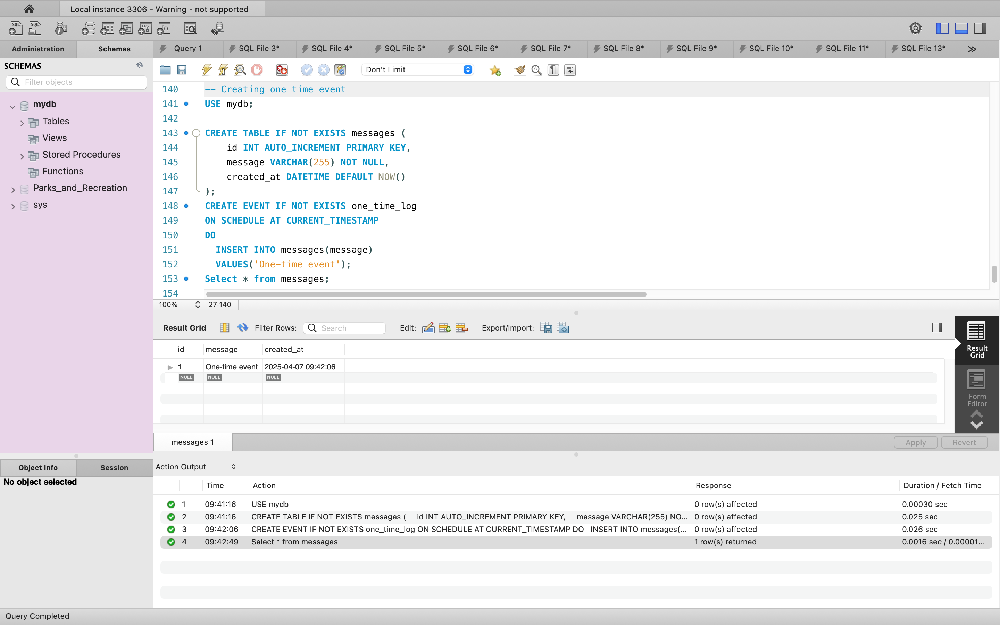

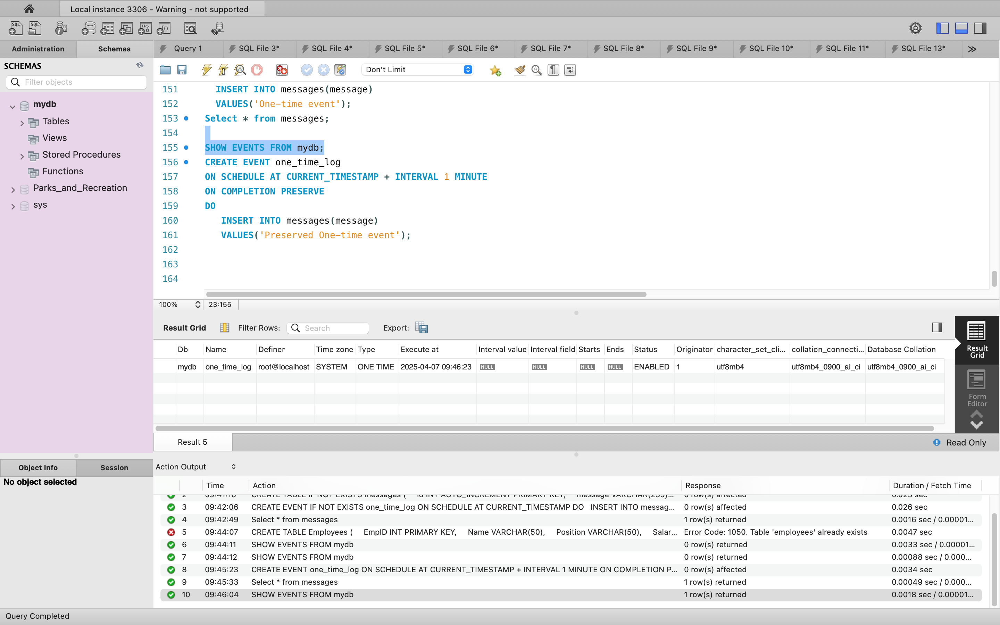

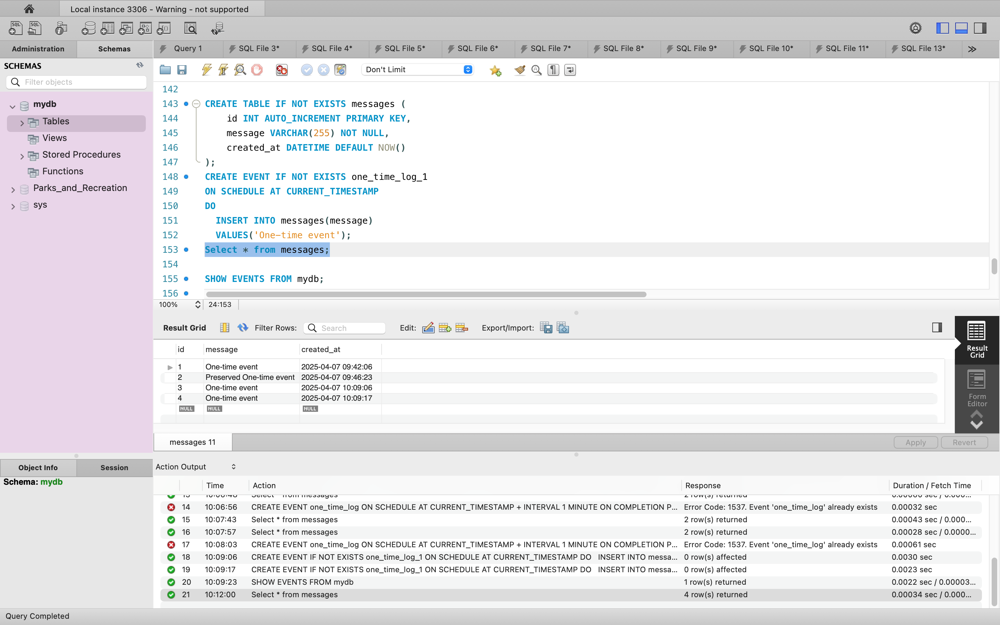

**Recurring Event**
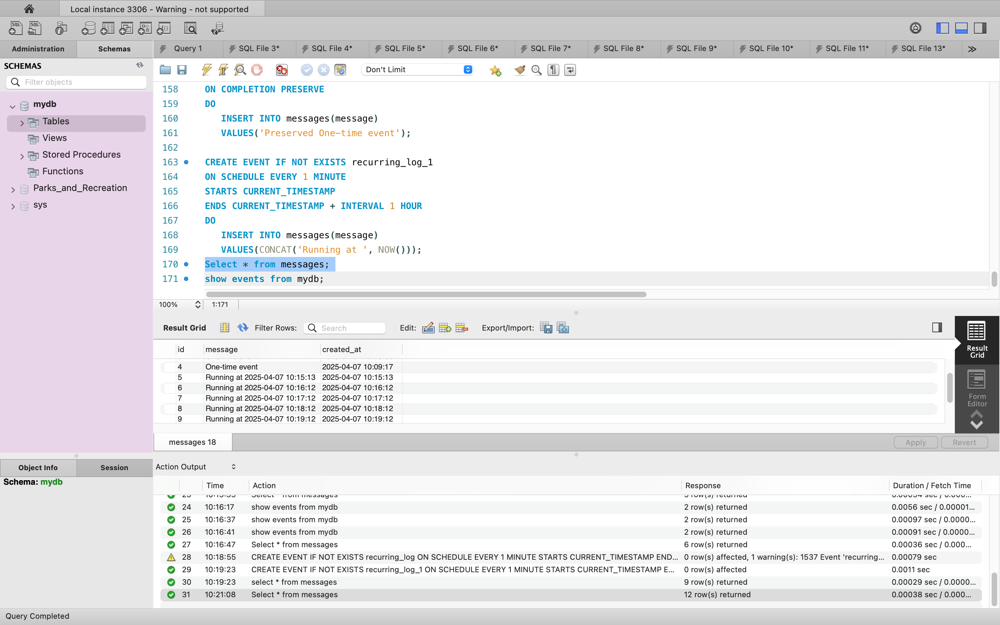

**Basic syntax of the SHOW EVENTS statement:**
```
SHOW EVENTS [FROM db_name]
[LIKE 'pattern' | WHERE expr];
```
- FROM db_name (optional):
 - Specify the database name after the SHOW EVENT keywords to instruct from which database you want to show the events.
 - If you omit the FROM clause, the statement shows events from the current database.
- LIKE 'pattern' (optional):
 - Allow you to filter the events based on a pattern.
 - You can include wildcards (% and _) in the pattern.
- WHERE expr (optional):
  - Allow you to form a more complex condition to filter the events, including event status.
- Examples:

 ```
SHOW EVENTS;
```
```
SHOW EVENTS FROM database_name;
```
```
 SHOW EVENTS LIKE 'daily%';
 ```
 ```
 SHOW EVENTS
 WHERE db = 'database_name' AND status = 'ENABLED';
 ```
 ```
 SHOW EVENTS WHERE status = 'DISABLED';
 ```

**ALTER EVENT**
- To change various attributes of an existing event using the ALTER EVENT statement.
```
ALTER EVENT [IF EXISTS] event_name
ON SCHEDULE schedule
[ON COMPLETION [NOT] PRESERVE]
[COMMENT 'comment']
[ENABLE | DISABLE]
DO event_body;
```

**DROP EVENT**

```
DROP EVENT [IF EXISTS] event_name [, event_name] ...;
```

#### **When to Use Events?**
 - Automated Data Cleanup (Deleting old logs, removing expired data)
 - Scheduled Updates (Updating inactive users, resetting daily stats)
 - Data Archiving (Moving old records to a backup table)
 - Recurring Reports (Generating daily/weekly/monthly reports)



**LAB**

**Lab_1. Auto-Generate Unique Usernames**
- **Task: Generate a username using the first three letters of the first name and last four digits of the phone number**
- 1. Creating the users and logins Tables
```
CREATE TABLE users (
    user_id INT PRIMARY KEY AUTO_INCREMENT,
    username VARCHAR(50) UNIQUE NOT NULL
  );
 CREATE TABLE logins (
    login_id INT PRIMARY KEY AUTO_INCREMENT,
    user_id INT,
    login_time TIMESTAMP DEFAULT CURRENT_TIMESTAMP,
    status ENUM('ACTIVE', 'LOGGED_OUT') DEFAULT 'ACTIVE',
    FOREIGN KEY (user_id) REFERENCES users(user_id) ON DELETE CASCADE
   );
```
```
CREATE TRIGGER trg_generate_username
BEFORE INSERT ON users
FOR EACH ROW
BEGIN
    SET NEW.username = CONCAT(LEFT(NEW.first_name, 3), RIGHT(NEW.phone, 4));
END;
```
- Creates a unique username before inserting a new user.

**Lab_2. Restrict Multiple Logins Per User**
- **Task**: **Allow only one active login per user**
- 1. Creating the users and logins Tables
```
CREATE TABLE users (
    user_id INT PRIMARY KEY AUTO_INCREMENT,
    username VARCHAR(50) UNIQUE NOT NULL
  );
 CREATE TABLE logins (
    login_id INT PRIMARY KEY AUTO_INCREMENT,
    user_id INT,
    login_time TIMESTAMP DEFAULT CURRENT_TIMESTAMP,
    status ENUM('ACTIVE', 'LOGGED_OUT') DEFAULT 'ACTIVE',
    FOREIGN KEY (user_id) REFERENCES users(user_id) ON DELETE CASCADE
   );
```





2. Creating the Trigger to Restrict Multiple Logins
```
DELIMITER //
CREATE TRIGGER restrict_multiple_logins
BEFORE INSERT ON logins
FOR EACH ROW
BEGIN
    DECLARE active_sessions INT;
    
    -- Count active login sessions for the user
    SELECT COUNT(*) INTO active_sessions
    FROM logins
    WHERE user_id = NEW.user_id AND status = 'ACTIVE';

    -- If active session exists, prevent new login
    IF active_sessions > 0 THEN
        SIGNAL SQLSTATE '45000'
        SET MESSAGE_TEXT = 'User already has an active session!';
    END IF;
 END //

 DELIMITER ;
 ```

**3. Testing the Trigger**
 ```
 INSERT INTO users (username) VALUES ('alice'), ('bob');
```

```
 -- First login (Should succeed)
 INSERT INTO logins (user_id) VALUES (1);
 -- Second login for the same user (Should fail)
 INSERT INTO logins (user_id) VALUES (1);
```

**Expected Output:**
- The first login succeeds, but the second attempt triggers an error:

   - ERROR 1644 (45000): User already has an active session!



**4. Logging Out a User**
```
 UPDATE logins
SET status = 'LOGGED_OUT'
WHERE user_id = 1 AND status = 'ACTIVE';
```

**Lab - Event Scheduler: Monthly Sales Report Generator Using SQL Events**

**Task: Automate the generation of monthly sales reports by creating a scheduled event that compiles data into a summary table at the end of each month.**

1. **Creating Necessary Tables**

```
 -- Table to store individual sales transactions
CREATE TABLE sales (
    sale_id INT PRIMARY KEY AUTO_INCREMENT,
    product_id INT,
    sale_amount DECIMAL(10, 2),
    sale_date DATE
);

-- Table to store the monthly aggregated sales report
CREATE TABLE monthly_sales_report (
    report_id INT PRIMARY KEY AUTO_INCREMENT,
    report_month DATE NOT NULL,
    total_sales DECIMAL(15, 2),
    total_transactions INT,
    generated_at TIMESTAMP DEFAULT CURRENT_TIMESTAMP
);
```

2. **Populating Sample Data**:
```
INSERT INTO sales (product_id, sale_amount, sale_date) VALUES
(101, 150.00, '2025-03-05'),
(102, 200.00, '2025-03-15'),
(103, 50.00, '2025-03-20'),
(101, 300.00, '2025-04-10'),
(102, 120.00, '2025-04-18'),
(103, 180.00, '2025-04-25');
```

**3. Creating the Scheduled Event**
- Create an event that runs at 11:59 PM on the last day of each month to aggregate sales data and store it in the monthly_sales_report table.
```
 DELIMITER $$

 CREATE EVENT generate_monthly_sales_report
ON SCHEDULE EVERY 1 MONTH
STARTS TIMESTAMP(CURRENT_DATE + INTERVAL 1 DAY) - INTERVAL 1 SECOND
DO
BEGIN
    DECLARE report_month YEAR_MONTH;
    SET report_month = DATE_FORMAT(CURRENT_DATE - INTERVAL 1 DAY, '%Y-%m');

    -- Insert aggregated data into the monthly_sales_report table
    INSERT INTO monthly_sales_report (report_month, total_sales, total_transactions)
    SELECT
        report_month,
        SUM(sale_amount) AS total_sales,
        COUNT(*) AS total_transactions
    FROM sales
    WHERE DATE_FORMAT(sale_date, '%Y-%m') = report_month;
 END $$

 DELIMITER ;
```
- The event is scheduled to run every 1 month, starting at 11:59:59 PM on the last day of the current month.​

- It calculates the total sales and the number of transactions for the month and inserts this data into the monthly_sales_report table.

**4. Testing the Event**
- Ensure the Event Scheduler is enabled:​
```
SET GLOBAL event_scheduler = ON;
```
- After the event runs, verify the contents of the monthly_sales_report table:​
```
SELECT * FROM monthly_sales_report;
```



5. Clean Up the event
```
DROP EVENT IF EXISTS generate_monthly_sales_report;
```

### **Views and Materialized Views**
  - Creating and Managing Views
  - Difference Between Views and Materialized Views

####**Views**
- A View is a virtual table based on the result of a SQL query.
- Does not store data itself, but provides a way to simplify complex queries.
- Acts like a window into your data.

**Why Use Views?**

**1. Virtual Representation:**
  - Views act as virtual tables, presenting data tailored to specific needs without duplicating data storage. ​

**2. Data Abstraction:**
 - They simplify complex queries by encapsulating intricate joins and filters, offering a more straightforward interface for data retrieval.

**3. Security Enhancement:**
 - Views can restrict access to sensitive data by displaying only specific columns or rows, thus controlling user access effectively.

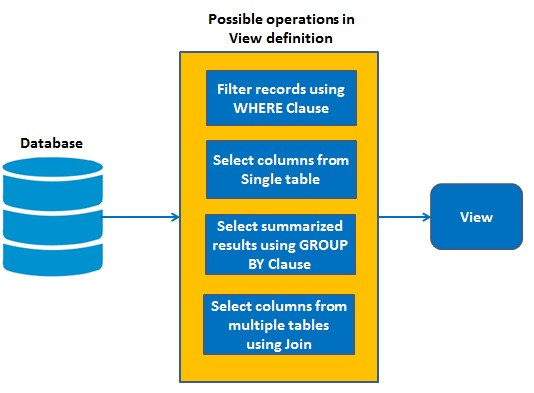

#### **Creating and Managing Views**
- **Syntax**:
```
CREATE VIEW view_name AS  
SELECT column1, column2  
FROM table_name  
WHERE condition;
```
- **Example:**
```
CREATE VIEW high_salary_employees AS  
SELECT name, salary  
FROM employees  
WHERE salary > 100000;
```
- **Using View**:
```
SELECT * FROM view_name;
```
- **Example:**
```
 SELECT * FROM high_salary_employees;
 ```
- **Updating a View**: Modify the logic of a view using:
```
 CREATE OR REPLACE VIEW view_name AS
  SELECT ...
```
- **Rename View**
```
 RENAME TABLE name_of_view TO new_view_name;
 ```
 - Example:
 ```
  RENAME TABLE daysofweek TO Day_of_the_week;
 ```
- **Droping View**
```
DROP VIEW view_name;
```
- **Checking Existing Views**
  - Syntax:
  ```
  SHOW FULL TABLES IN db_name WHERE TABLE_TYPE = 'VIEW';
  ```
  
```
 SHOW FULL TABLES IN mydb WHERE TABLE_TYPE = 'VIEW';
 ```
  


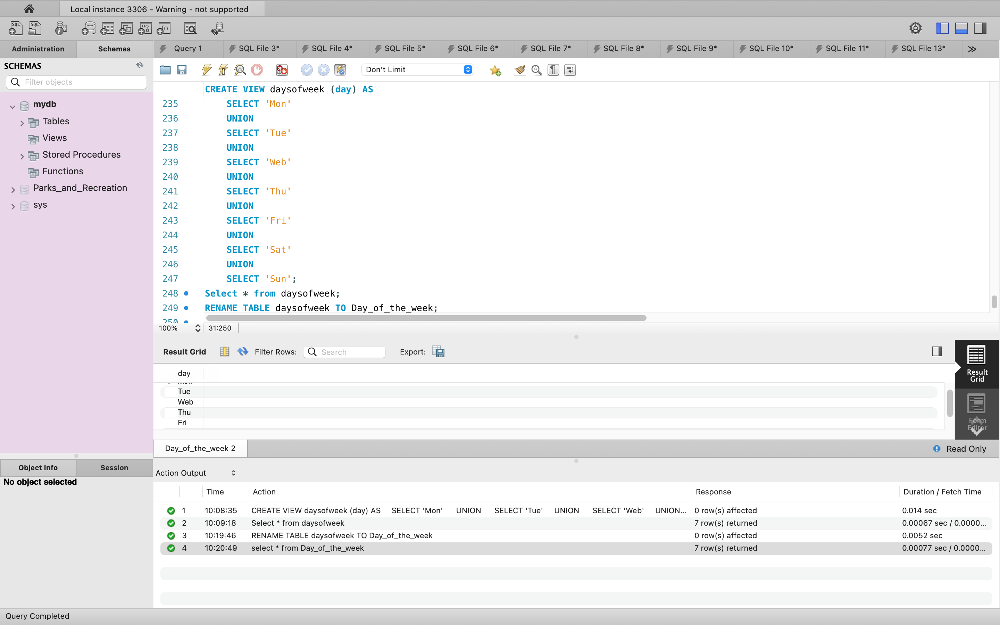

**Types of Views**
- Simple Views (from a single table, no functions or joins)
- Complex Views (involve joins, aggregations, subqueries)
- Updatable Views (can be used to update the underlying table—depends on DBMS rules)
- Read-Only Views (common when using GROUP BY, joins, etc.)



**Simple View**:
 - A simple view is based on a single table.
 - Contains no joins, aggregations, or subqueries.
 - Often used to:
   - Simplify frequent queries
   - Hide specific columns
   - Provide a consistent interface for users
 - Example:
 ```
  CREATE VIEW active_employees AS
  SELECT employee_id, name, department
  FROM employees
  WHERE status = 'Active';
```

-  Updating Data Through Simple Views
 - If the view is directly mapped to one table and doesn’t have derived columns, you can update the base table through the view.
```
 UPDATE active_employees
 SET department = 'Support'
 WHERE employee_id = 105;
```

**Complex View:**

A complex view is a virtual table created from:
  - Multiple tables (joins)
  - Aggregations (SUM(), AVG(), etc.)
  - GROUP BY / HAVING
  - Subqueries
  - Expressions / functions

**Why to use Complex views?**
- Simplification:
  - Hides complex query logic from end users
- Reusability
  - Acts like a reusable query template
- Reporting
  - Useful for building reporting dashboards
- Security
  - Restrict access to only specific columns/rows

 **Syntax Example –** With Join, Aggregation, and Grouping
 - Task: To find the summary of total order amount per customer, including their contact info.
 ```
 CREATE VIEW customer_order_summary AS --Define view
 SELECT     --Write a query to get summary of total order
    c.customer_id,
    c.customer_name,
    c.email,
    COUNT(o.order_id) AS total_orders,
    SUM(o.total_amount) AS total_spent
 FROM
    customers c
 JOIN    -- Joins to customer and orders table
    orders o ON c.customer_id = o.customer_id
 GROUP BY
    c.customer_id, c.customer_name, c.email;
```

- Querying the view
```
SELECT * FROM customer_order_summary
WHERE total_spent > 1000;
```



**Example With Case**
- You want a view that shows:
  - Customer name, Total order amount
  - A status field that shows:
   - 'High Value' if total > 1000
   - 'Medium Value' if total between 500–1000
   - 'Low Value' if total < 500

```
  -- Create view
  CREATE VIEW customer_value_summary AS
   SELECT c.c.customer_name,
    SUM(o.total_amount) AS total_spent,
    CASE
        WHEN SUM(o.total_amount) > 1000 THEN 'High Value'
        WHEN SUM(o.total_amount) BETWEEN 500 AND 1000 THEN 'Medium Value'
        ELSE 'Low Value'
    END AS customer_status
   FROM
    customers c
   JOIN
    orders o ON c.customer_id = o.customer_id
   GROUP BY
    c.customer_id, c.customer_name;
```
   - SUM(o.total_amount) aggregates total spending.
   - CASE evaluates the result of that sum and assigns a category.
   - The view creates a ready-to-use summary table for dashboards or reports.

- Query the view
```
 SELECT * FROM customer_value_summary
 WHERE customer_status = 'High Value';
```




**Updatable View**
- An updatable view is a virtual table that allows:
  - INSERT
  - UPDATE
  - DELETE

 directly through the view—affecting the underlying base table(s).

- When allowed, they behave like a regular table for data manipulation.
- Example:
 - Consider Base Table
 ```
 CREATE TABLE employees (
    employee_id INT PRIMARY KEY,
    name VARCHAR(100),
    department_id INT,
    salary DECIMAL(10, 2)
);
```
- Create View:
 ```
 CREATE VIEW hr_employees AS
 SELECT employee_id, name, salary
 FROM employees;
 ```
- Update table
```
  -- This updates the employees table.
  UPDATE hr_employees SET salary = 75000 WHERE employee_id = 101;
  ```



**Rules For a view to be updatable:**

- Must reference only one base table

- No DISTINCT, GROUP BY, HAVING, UNION, AGGREGATES (like SUM)

- All columns to be updated must map directly to base table columns

- No computed columns or expressions

- No JOINs (in most DBMSs; some support limited updates via INSTEAD OF triggers)

**Read-Only View**
- A Read-Only View is a view that:
 - You can SELECT from
 - But you cannot INSERT, UPDATE, or DELETE through
 - It’s typically the result of a complex query involving:
   - GROUP BY
   - Aggregation (SUM, COUNT, etc.)
   - Subqueries
   - Calculated fields
   - Joins with condtions.
- The SELECT statement of the view does not contain sub-queries, a DISTINCT predicate, a HAVING clause, aggregate functions, joined tables, user-defined functions, or stored procedures.
If the view definition does not meet all of these conditions, it is considered read-only.
- Example:  Read-Only View with GROUP BY
```
CREATE VIEW department_salary_summary AS
SELECT
    department_id,
    AVG(salary) AS avg_salary,
    COUNT(*) AS total_employees
FROM
    employees
GROUP BY
    department_id;
```
- Use the view:
```
SELECT * FROM department_salary_summary;
```
- Update table:
```
UPDATE department_salary_summary
SET avg_salary = 75000
WHERE department_id = 3;
```
  - This give error.


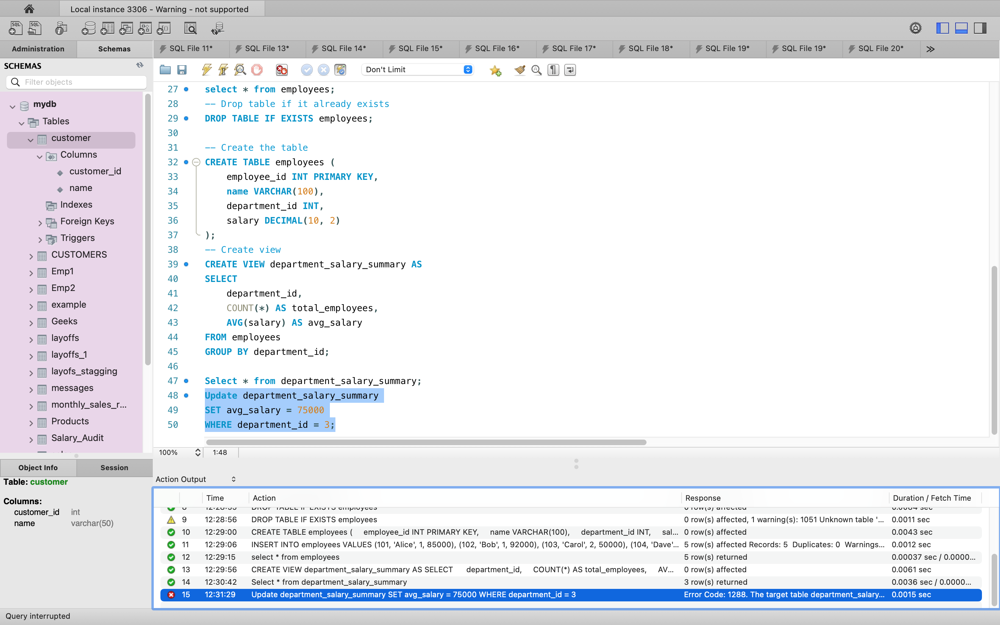

**Why Use Read-Only Views?**
- Reporting
   - Ideal for dashboards, summaries, and KPIs
- Security
  - Prevents users from changing data
- Data modeling
 - Encapsulates complex business logic in one place
- Reusability
 - Can be reused across multiple queries or apps

#### **Lab: Views**

 **Task1 : Drop & Create Tables**
 ```
 DROP TABLE IF EXISTS orders;
DROP TABLE IF EXISTS customers;

CREATE TABLE customers (
    customer_id INT PRIMARY KEY,
    customer_name VARCHAR(100),
    region VARCHAR(50)
);

CREATE TABLE orders (
    order_id INT PRIMARY KEY,
    customer_id INT,
    order_date DATE,
    order_amount DECIMAL(10, 2),
    status VARCHAR(20),
    FOREIGN KEY (customer_id) REFERENCES customers(customer_id)
);
```

**2: Insert Sample Data**
```

INSERT INTO customers VALUES
(1, 'Alice', 'North'),
(2, 'Bob', 'South'),
(3, 'Carol', 'East'),
(4, 'Dave', 'West');

INSERT INTO orders VALUES
(1001, 1, '2024-10-01', 250.00, 'Shipped'),
(1002, 1, '2024-10-15', 1200.00, 'Delivered'),
(1003, 2, '2024-11-03', 750.00, 'Cancelled'),
(1004, 3, '2024-11-10', 900.00, 'Shipped'),
(1005, 4, '2024-12-05', 150.00, 'Delivered'),
(1006, 1, '2025-01-01', 300.00, 'Shipped');
```

**3: Create Read-Only Views**

```
 -- View 1: Aggregated Orders by Customer
CREATE VIEW customer_order_summary AS
SELECT
    c.customer_id,
    c.customer_name,
    COUNT(o.order_id) AS total_orders,
    SUM(o.order_amount) AS total_spent,
    CASE
        WHEN SUM(o.order_amount) > 1000 THEN 'High Value'
        WHEN SUM(o.order_amount) BETWEEN 500 AND 1000 THEN 'Medium Value'
        ELSE 'Low Value'
    END AS value_segment
FROM
    customers c
JOIN
    orders o ON c.customer_id = o.customer_id
GROUP BY
    c.customer_id, c.customer_name;
```

**View 2: Active Orders with JOIN**
```
CREATE VIEW active_orders_view AS
SELECT
    o.order_id,
    c.customer_name,
    o.order_amount,
    o.status
FROM
    orders o
JOIN
    customers c ON o.customer_id = c.customer_id
WHERE
    o.status IN ('Shipped', 'Delivered');



 **4: Attempt These and Observe Failures**

-  UPDATE on an aggregate view - should fail
```
 UPDATE customer_order_summary SET total_spent = 2000 WHERE customer_id = 1;
```
- DELETE on a JOIN view - should fail
```
DELETE FROM active_orders_view WHERE order_id = 1001;
```


**5: Create an Updatable View**
 ```
CREATE VIEW editable_orders AS
SELECT order_id, customer_id, order_amount, status
FROM orders;
 ```

- UPDATE through an updatable view - should succeed
```
UPDATE editable_orders SET status = 'Delivered' WHERE order_id = 1006;
```

**Example of safe updatae mode.**

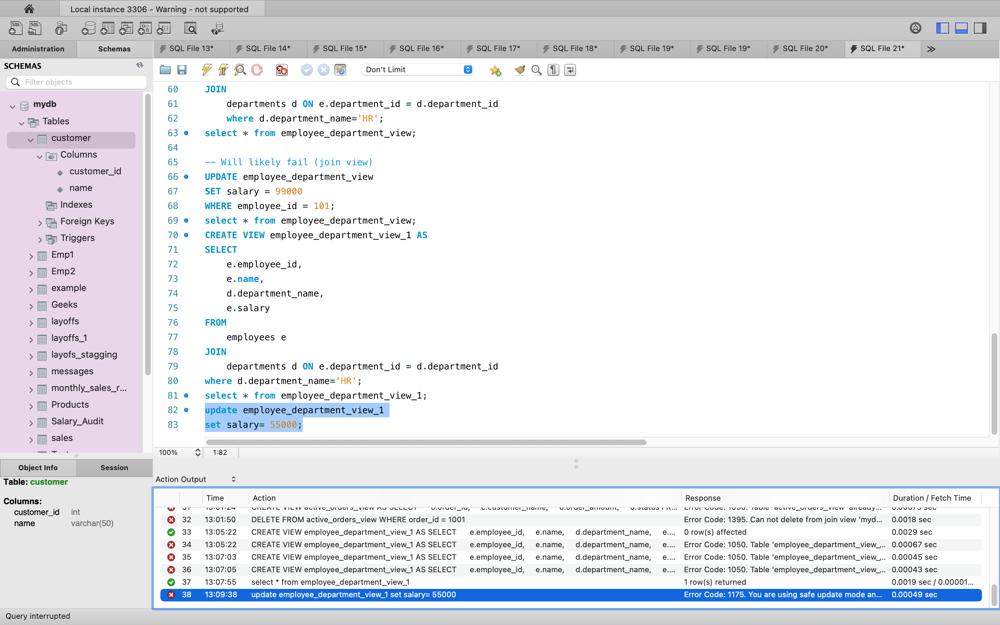

**Materialized View**
- A physical table that stores the results of the query.
- Data is not automatically updated when the underlying tables change.
- Provides faster query results for expensive operations like joins or aggregations, at the cost of requiring periodic refreshes.
- Materialized view is not supported in MySQL,but you can simulate one using a regular table along with manual or scheduled refreshes.
- Syntax:
```
 CREATE MATERIALISED VIEW materialise_view_name AS  
SELECT column1, column2  
FROM table_name  
WHERE condition;
```


#### **Steps to Simulate Materialized Views in MySQL**

**Step 1: Create a Table to Simulate the Materialized View**
- In MySQL, we create a table that will hold the result of the query (the materialized view).
```
 -- Drop the simulated materialized view table if it exists
DROP TABLE IF EXISTS customer_spend_summary;

  -- Create the table to simulate the materialized view
CREATE TABLE customer_spend_summary AS
SELECT
    c.customer_id,
    c.customer_name,
    SUM(o.order_amount) AS total_spent
FROM customers c
JOIN orders o ON c.customer_id = o.customer_id
GROUP BY c.customer_id, c.customer_name;
```

**Step 2: Create Trigger to Simulate Refreshing**
- This table is now a "materialized view" — it stores the result of a summary query.
```
 DELIMITER $$
 CREATE TRIGGER refresh_customer_spend_after_insert
 AFTER INSERT ON orders
 FOR EACH ROW
 BEGIN
    INSERT INTO customer_spend_summary (customer_id, customer_name, total_spent)
    SELECT c.customer_id, c.customer_name, SUM(o.order_amount)
    FROM customers c
    JOIN orders o ON c.customer_id = o.customer_id
    WHERE c.customer_id = NEW.customer_id
    GROUP BY c.customer_id, c.customer_name
    ON DUPLICATE KEY UPDATE total_spent = VALUES(total_spent);
 END $$

 DELIMITER ;
```

**Use Cases**
- Aggregated sales dashboards
- Weekly reports
- Expensive joins
- Dimensional modeling (star/snowflake schemas)



#### **Difference Between Views and Materialized Views**

**Feature**	| **View**| **Materialized View**
--------|----|---------------------
**Definition**|	A virtual table based on a SQL query	A physical table that stores query results
**Storage**|	No data stored; query runs each time|	Stores data physically like a regular table
**Refresh**	|Always shows up-to-date data	| Needs manual or scheduled refresh to stay current
**Performance**	|Slower on large datasets (runs on demand)	|Faster for read-heavy operations (precomputed)
**Use Case**|	When data needs to be real-time|	When performance is more important than real-time data
**Editable**|	Often not directly editable|Can be updated like a regular table (in some DBs)
**Triggers/Indexes**	|Cannot have indexes	|Can have indexes and constraints
**Supported in MySQL?**|	✅ Yes|	❌ Not natively (simulated using tables + refresh logic)

**LAB: Create Materialized View Using Event**

**Step 1: Make Sure Scheduler is ON.**
```
 SET GLOBAL event_scheduler = ON;
```

**Step 2: Create Events**
```
 DELIMITER $$

CREATE EVENT refresh_mv_customer_sales_summary
ON SCHEDULE EVERY 1 HOUR
DO
BEGIN
    TRUNCATE TABLE mv_customer_sales_summary;

    INSERT INTO mv_customer_sales_summary
    SELECT
        c.id AS customer_id,
        c.name,
        COUNT(o.id),
        SUM(o.total_amount)
    FROM customers c
    LEFT JOIN orders o ON c.id = o.customer_id
    GROUP BY c.id, c.name;
END $$

DELIMITER ;
```

### **Window Functions**

 - **Window functions** use values from multiple rows to produce values for each row separately.
 - In other words, they perform calculations on the set of rows related to the current row.
 - That **set of rows** is known as **'window'**, hence the name **'window functions'**.

- **Syntax:**

  ```
  SELECT
  window_function() OVER(
          PARTITION BY partition_expression
         ORDER BY order_expression
         window_frame_extent
     ) AS window_column_alias
    FROM table_name;
    ```
  - window_function()	The window function you want to apply (e.g., SUM, ROW_NUMBER)
  - OVER()	Defines the window of rows to perform the calculation on
  - PARTITION BY	(Optional) Groups rows for separate window calculations (like GROUP BY)
  - ORDER BY	(Optional) Orders rows within each partition
  - ROWS BETWEEN	(Optional) Specifies a range of rows (e.g., previous 1 row to next 1 row)


#### **Types of Window Functions**
- Aggregate Window Functions
- Ranking Window Functions
- Value Window Functions



**Aggregate Window function**
- They are standard SQL aggregate functions like SUM(), AVG(), MIN(), MAX(), COUNT() used with the OVER() clause to compute aggregated values over a window (set) of rows, without collapsing rows like GROUP BY does.
- Syntax:
```
AGG_FUNCTION(expression) OVER (
    [PARTITION BY column]
    [ORDER BY column]
    [ROWS BETWEEN frame_clause]
)
```
- **Example: Running Total Using SUM()**
```
SELECT
    employee_id,
    sale_date,
    sale_amount,
    SUM(sale_amount) OVER (
        PARTITION BY customer_id
        ORDER BY order_date
    ) AS running_total
FROM orders;
```


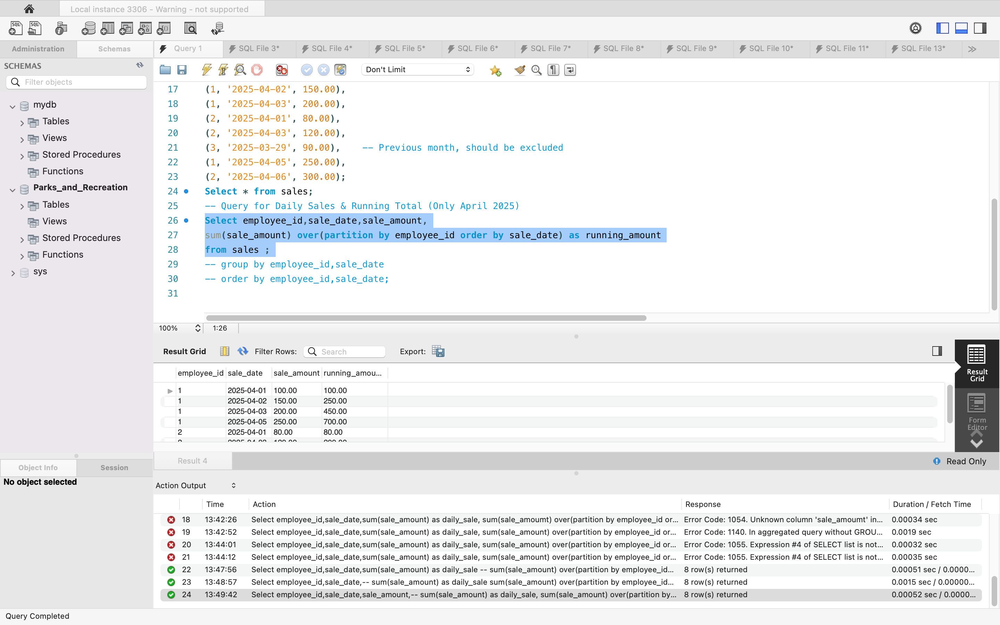

**Example**: **Moving Average**:
- A moving average smooths data by calculating the average of a sliding window of values.(like a 3-day or 7-day average).
- It's widely used in time-series analysis like sales trends, stock prices, etc.
```
 Select employee_id,sale_date,sale_amount,
Avg(sale_amount) over(partition by employee_id order by sale_date) as running_average,
Avg(sale_amount) over(partition by employee_id order by sale_date ROWS BETWEEN 2 PRECEDING AND CURRENT ROW
) as running_average_3days
from sales ;
```
- ``` ROWS BETWEEN UNBOUNDED PRECEDING AND CURRENT ROW```: This cause defines window functions for aggregate functions.
- ```UNBOUNDED PRECEDING``` : Start from the first row in the partition (i.e., beginning of the group)
-``` N PRECEDING ```:  Includes previous 2 Rows + Current Row
- ``` ROWS BETWEEN 2 PRECEDING AND 1 FOLLOWING```:	2 rows before and 1 row after
- ``` UNBOUNDED FOLLOWING```: Current row and all after it





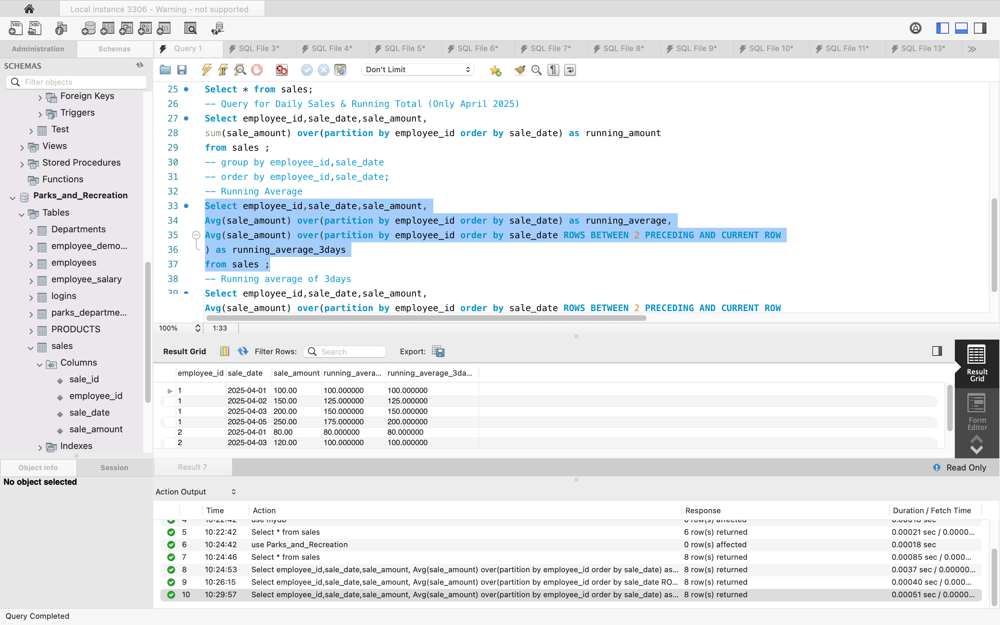



#####**Ranking Window Functions**
- Ranking window functions are super useful when you want to assign a rank or order to rows within partitions
- For example, ranking employees by sales within departments, or products by revenue per category.
- **ROW_NUMBER()** :	Assigns a unique sequential number to each row in a partition
- **RANK()**: Similar to ROW_NUMBER(), but gives same rank for ties (gaps allowed)
- **DENSE_RANK()**:	Like RANK(), but no gaps between ranks in case of ties
- **NTILE(n)**	Divides rows into n roughly equal groups
- **Example: Query with All Ranking Functions**
```
 Select  employee_id,sale_date,sale_amount ,
 ROW_NUMBER() OVER (PARTITION BY sale_date ORDER BY sale_amount DESC) AS row_num,
    RANK()       OVER (PARTITION BY sale_date ORDER BY sale_amount DESC) AS rank_pos,
    DENSE_RANK() OVER (PARTITION BY sale_date ORDER BY sale_amount DESC) AS dense_rk,
    NTILE(3)     OVER (PARTITION BY sale_date ORDER BY sale_amount DESC) AS tile_group
from sales;
```

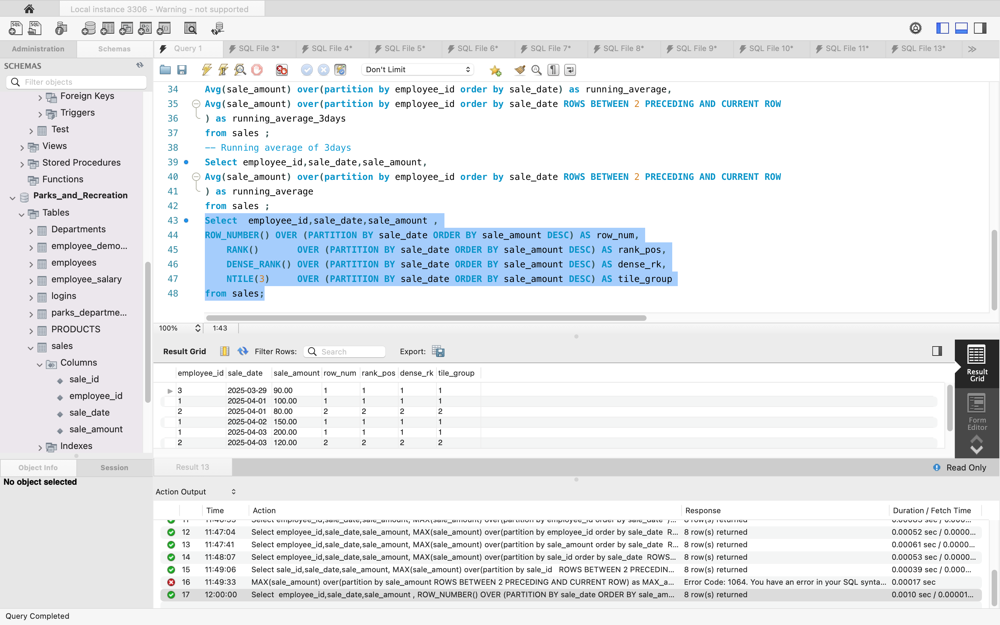

#####**Value Window Functions**
- These allow you to look forward, backward, or across rows in your partition to compare values, calculate changes, or pull data from other rows.
- **LAG(column, offset, default)**	: Gets value from previous row in the partition
- **LEAD(column, offset, default)** : Gets value from next row in the partition
- **FIRST_VALUE(column)** :	Gets the first value in the window frame
- **LAST_VALUE(column)** : Gets the last value in the window frame
- **NTH_VALUE(column, n)** : Gets the nth value in the window frame
- Example:
```
 Select  employee_id,sale_date,sale_amount,
LAG(sale_amount) OVER(ORDER BY sale_date) AS pre_sale_amount,
LEAD(sale_amount) OVER (ORDER BY sale_date) AS next_day_sale,
    FIRST_VALUE(sale_amount) OVER (ORDER BY sale_date) AS first_day_sale_amount,
    LAST_VALUE(sale_amount) OVER (
        ORDER BY sale_date
        ROWS BETWEEN UNBOUNDED PRECEDING AND UNBOUNDED FOLLOWING
    ) AS last_day_sale_amount,
    NTH_VALUE(sale_amount, 3) OVER (ORDER BY sale_date
        ROWS BETWEEN UNBOUNDED PRECEDING AND UNBOUNDED FOLLOWING
    ) AS third_day_sale_amount
from sales;
```

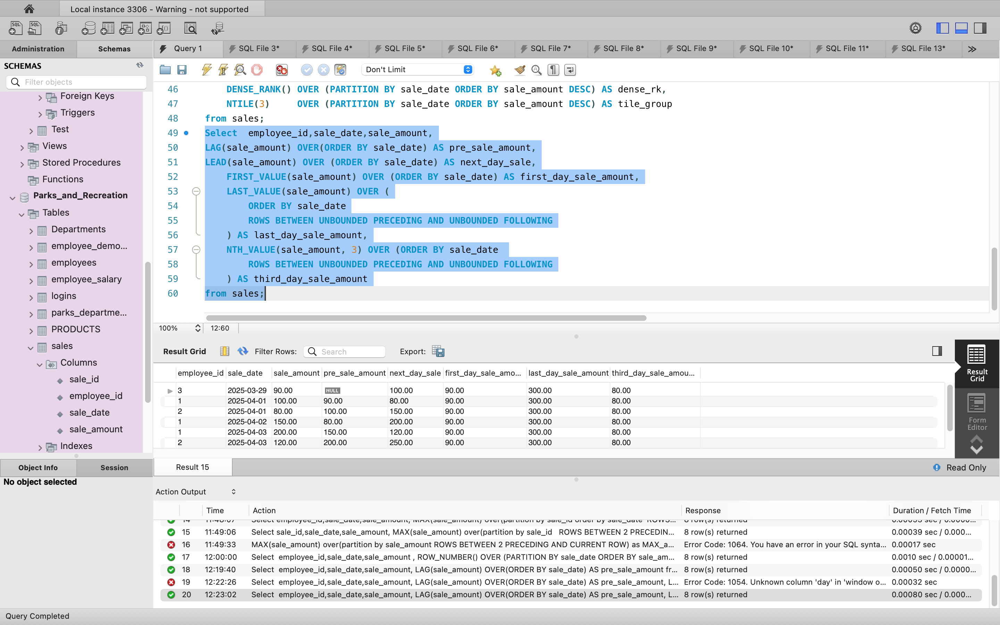

#### **When to Use Window Functions:**
- Ranking top-N items per group
- Running totals / moving averages
- Comparing current row to previous/next (time series)
- Gap analysis
- Percentiles and cumulative distributions



#### **LAB:**  **Window Functions to test multiple concepts: ranking, sessionizing, lag/lead, and frame specification**

**Task 1: Create Table named  "user_events"**
```
  -- Create table user_events
 DROP TABLE IF EXISTS user_events;

 CREATE TABLE user_events (
    event_id INT AUTO_INCREMENT PRIMARY KEY,
    user_id INT NOT NULL,
    event_type ENUM('login', 'logout', 'purchase') NOT NULL,
    event_time DATETIME NOT NULL,
    amount DECIMAL(10,2) DEFAULT NULL
);
 -- Insert data into user_events
INSERT INTO user_events (user_id, event_type, event_time, amount) VALUES
(101, 'login',    '2024-12-01 09:00:00', NULL),
(101, 'purchase', '2024-12-01 10:00:00', 120.00),
(101, 'purchase', '2024-12-01 14:00:00', 300.00),
(101, 'logout',   '2024-12-01 15:00:00', NULL),
(102, 'login',    '2024-12-02 10:00:00', NULL),
(102, 'purchase', '2024-12-02 11:15:00', 75.00),
(103, 'login',    '2024-12-01 12:00:00', NULL),
(103, 'purchase', '2024-12-01 12:30:00', 180.00),
(101, 'purchase', '2024-12-03 12:30:00', 100.00);
 -- View the table data
SELECT * FROM user_events;
```


**Task 2: Rank Purchases Per User by Time (Most Recent First)**
```
 SELECT *,
  RANK() OVER (PARTITION BY user_id ORDER BY event_time DESC) AS purchase_rank
  FROM user_events
  WHERE event_type = 'purchase';
```

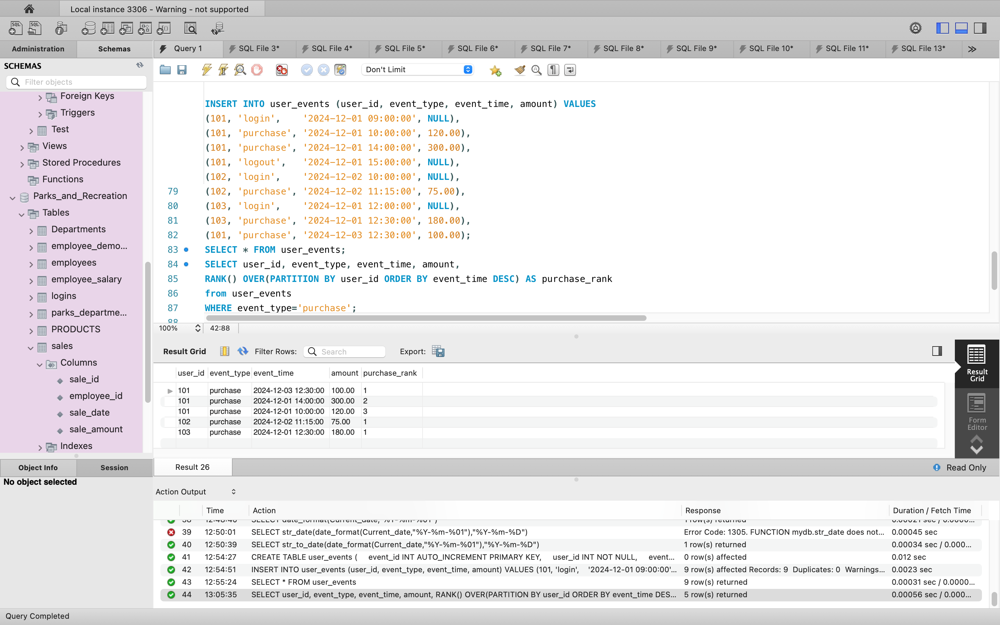

**Task 3: Calculate Time Between Purchases (Lag)**
```
 SELECT *,
  TIMESTAMPDIFF(MINUTE,
    LAG(event_time) OVER (PARTITION BY user_id ORDER BY event_time),
    event_time) AS minutes_since_last_event
FROM user_events
WHERE event_type = 'purchase';
```

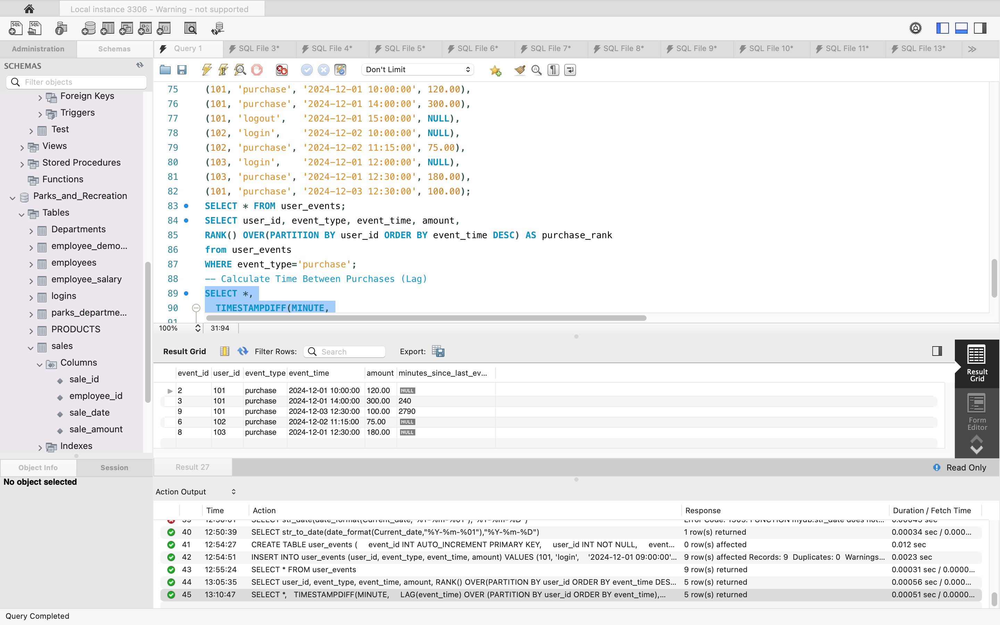

**Task 3: Compute Rolling Sum of Purchases in Last 1 Day Per User**
```
SELECT *,
  SUM(amount) OVER (
    PARTITION BY user_id
    ORDER BY event_time
    RANGE BETWEEN INTERVAL 1 DAY PRECEDING AND CURRENT ROW
  ) AS rolling_daily_spend
FROM user_events
WHERE event_type = 'purchase';
```

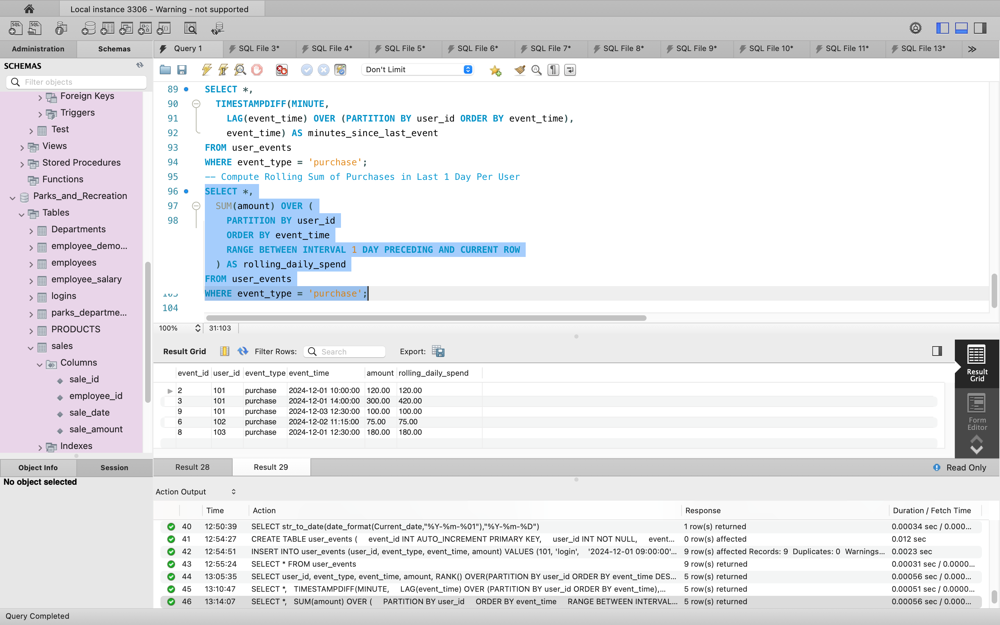

**Task 4: Detect Sessions (Gap > 30 Minutes = New Session)**
```
 SELECT *,
  CASE
    WHEN TIMESTAMPDIFF(MINUTE,
        LAG(event_time) OVER (PARTITION BY user_id ORDER BY event_time),
        event_time) > 30 THEN 1
    ELSE 0
  END AS is_new_session
FROM user_events;
```

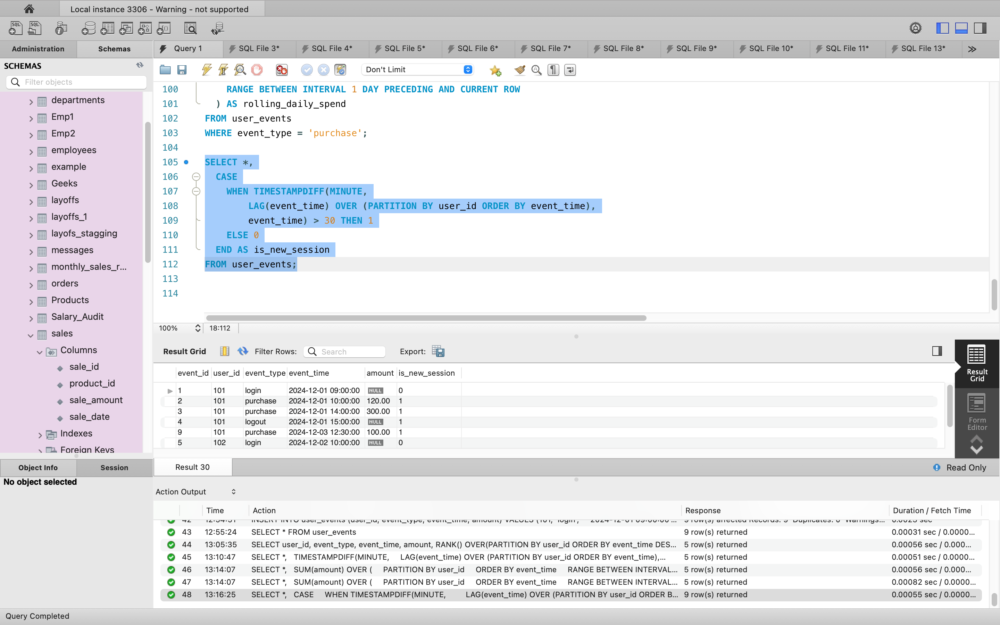

**Task 5: Session Ranking and Running Total**
-  A session is defined as a sequence of events by a user where no two consecutive events are more than 30 minutes apart.
- If the gap is more than 30 minutes, it starts a new session.
- First,detect Where a New Session Begins , then assign a Session ID Using a Running SUM

```
 -- Dedine CTE to detect session and sessioned event

 WITH ordered_events AS (
  SELECT *,
    CASE
      WHEN TIMESTAMPDIFF(MINUTE,
          LAG(event_time) OVER (PARTITION BY user_id ORDER BY event_time),
          event_time) > 30 THEN 1
      ELSE 0
    END AS session_split
  FROM user_events
),
sessioned_events AS (
  SELECT *,
    SUM(session_split) OVER (PARTITION BY user_id ORDER BY event_time) AS session_id
  FROM ordered_events
)
SELECT
  user_id,
  session_id,
  event_time,
  event_type,
  SUM(amount) OVER (PARTITION BY user_id, session_id ORDER BY event_time) AS running_session_total
FROM sessioned_events
WHERE event_type = 'purchase';
```

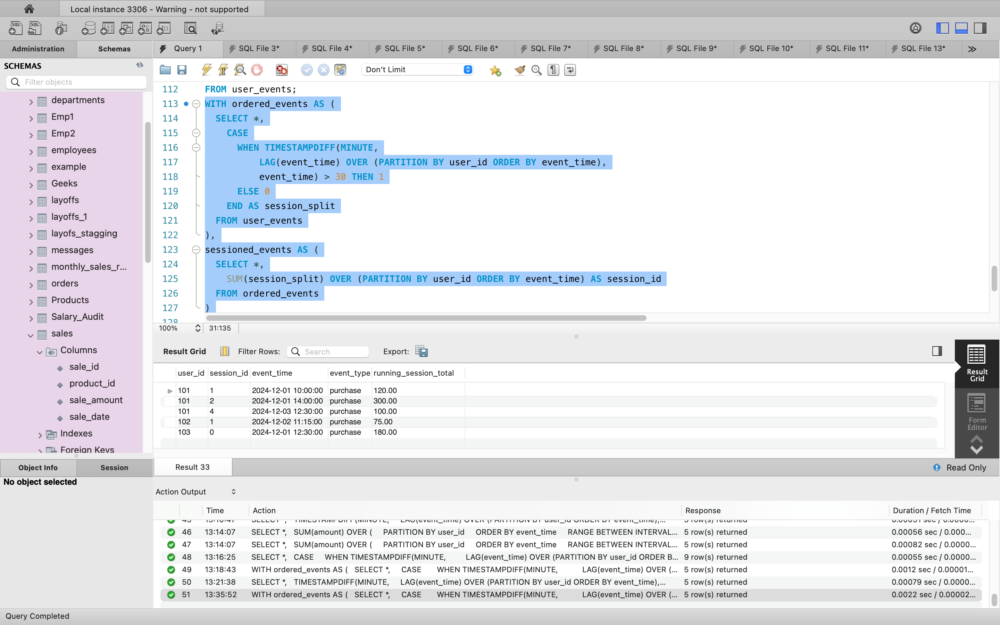

#### **Pivot And Unpivot**

- **PIVOT** and **UNPIVOT** are powerful operations used to transform data and make it more readable, efficient, and manageable.
- Rotate data from rows to columns.
- Useful when we need to summarize, aggregate, or reorganize data for reporting purposes.
- Use GROUP BY with CASE when your DB doesn’t support PIVOT.
- Avoid PIVOT with too many distinct values (hundreds of columns).
- Always sanitize/validate dynamic SQL if you’re dynamically pivoting (e.g., via stored procedures or scripts).
- Syntax For Pivot (Not Applicable for MySQL):
```
 SELECT (ColumnNames)
FROM (TableName)
PIVOT
 (
   AggregateFunction(ColumnToBeAggregated)
   FOR PivotColumn IN (PivotColumnValues)
 ) AS (Alias) //Alias is a temporary name for a table
```
- Syntax for Unpivot (Not supported by MySQL)
 ```
  SELECT (ColumnNames)
FROM (TableName)
UNPIVOT
(AggregateFunction(ColumnToBeAggregated)
FOR PivotColumn IN (PivotColumnValues)
) AS (Alias)
```

**When to Use Pivot and Unpivot in SQL?**
- **PIVOT**: When you need to summarize or aggregate data and display it in a columnar format, typically for reporting purposes.
- **UNPIVOT**: When you need to convert column data back to rows, often after performing a PIVOT operation, for normalization or further analysis.

#### **Lab**

**Step 1. Create Table and Inser**t Data
```
 CREATE TABLE sales_data (
    id INT AUTO_INCREMENT PRIMARY KEY,
    month VARCHAR(10),
    region VARCHAR(20),
    sales INT
);

INSERT INTO sales_data (month, region, sales) VALUES
('Jan', 'East', 100),
('Jan', 'West', 200),
('Feb', 'East', 150),
('Feb', 'West', 250),
('Mar', 'East', 130),
('Mar', 'West', 180);
```

**Step 2: Pivot the Data**

**Goal: Convert rows into columns — i.e., show East and West sales in separate columns for each month.**
```
 SELECT
    month,
    SUM(CASE WHEN region = 'East' THEN sales ELSE 0 END) AS east_sales,
    SUM(CASE WHEN region = 'West' THEN sales ELSE 0 END) AS west_sales
 FROM sales_data
 GROUP BY month
 ORDER BY FIELD(month, 'Jan', 'Feb', 'Mar');  -- Optional: keeps the month order
```

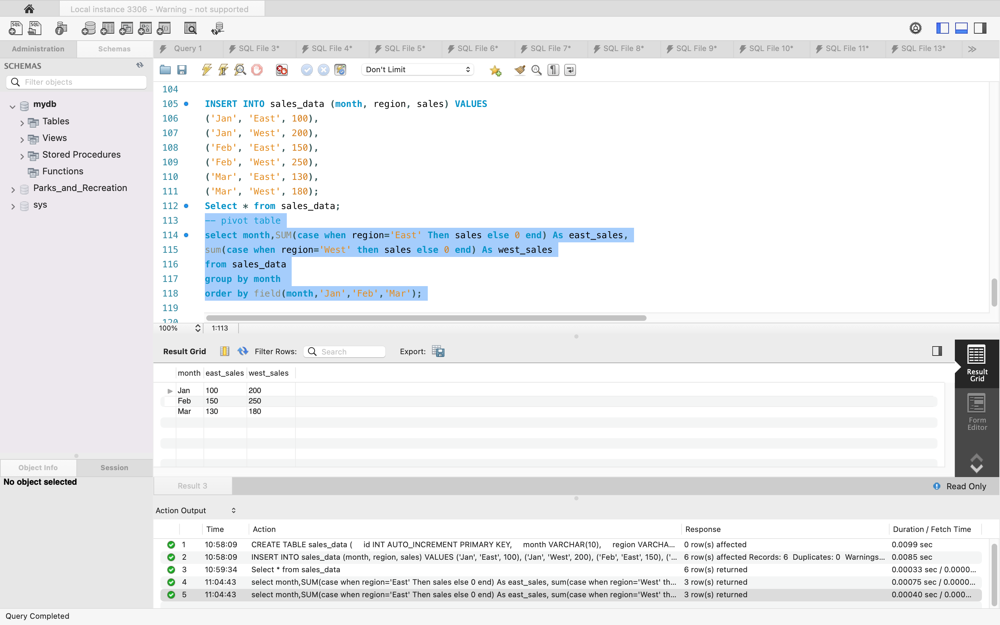

**Step 3: Create table with Pivoted data.**
```
 CREATE TABLE pivoted_sales AS
 SELECT
    month,
    SUM(CASE WHEN region = 'East' THEN sales ELSE 0 END) AS east_sales,
    SUM(CASE WHEN region = 'West' THEN sales ELSE 0 END) AS west_sales
 FROM sales_data
 GROUP BY month;
```

**Step 4 : Unpivot the Data**
```
 SELECT month, 'East' AS region, east_sales AS sales FROM pivoted_sales
UNION ALL
 SELECT month, 'West' AS region, west_sales AS sales FROM pivoted_sales;
```

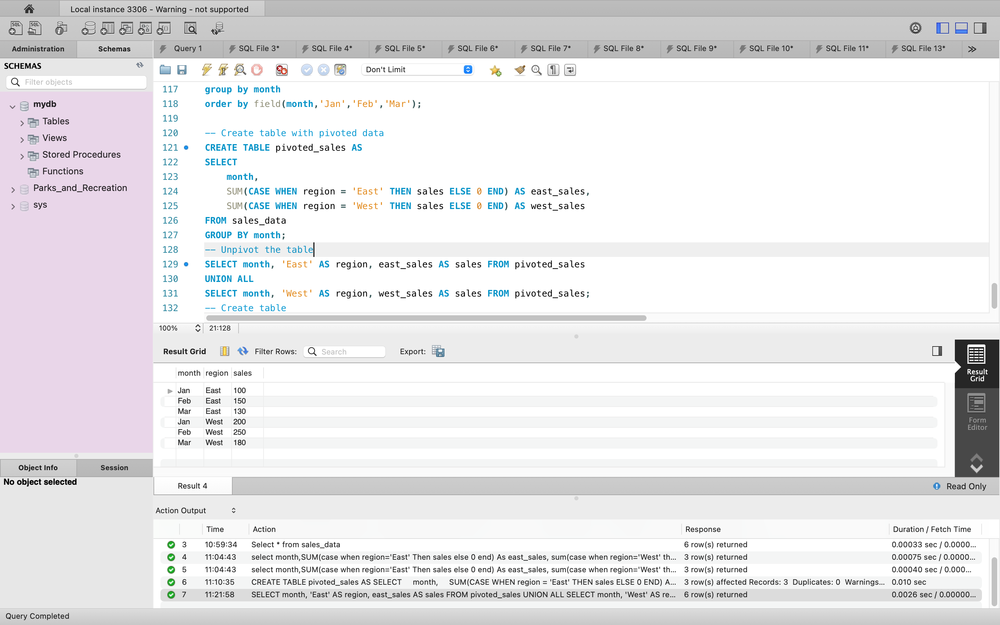

---
### **Conclusion**

- Indexes boost query performance; clustered vs non-clustered affect storage and access.
- Use EXPLAIN PLAN to analyze and optimize queries.
- Stored Procedures and User-Defined Functions enable reusable, modular logic.
- Triggers automate responses to data changes; events schedule tasks.
- Views simplify complex queries; materialized views store results for speed.
- Window Functions allow powerful analytics like running totals, rankings, and moving averages—without grouping data.
- PIVOT and UNPIVOT are powerful operations used to transform data and make it more readable, efficient, and manageable.



---
###**References**
- https://dev.mysql.com/blog-archive/mysql-explain-analyze/
- https://digma.ai/how-indexing-enhances-query-performance/#:~:text=improve%20database%20performance%3F-,Indexes%20speed%20up%20data%20retrieval%20by%20allowing%20the%20database%20to,execution%2C%20especially%20for%20large%20datasets.
- https://materialize.com/guides/materialized-views/
- https://www.stratascratch.com/blog/the-ultimate-guide-to-sql-window-functions/#frame_specifications
- https://mode.com/sql-tutorial/sql-window-functions